In [1]:
import xarray as xr
import matplotlib.pyplot as plt
import torch
import pandas as pd
import seaborn as sns
import numpy as np
from mpl_toolkits.basemap import Basemap
import geopandas as gpd
from esda.moran import Moran
from eval.metrics import *
from eval.plot import *
import data.valid_crd as valid_crd
import os
import yaml
import data.helper as helper
from matplotlib.colors import ListedColormap
import math
import scipy.stats as stats
# import statsmodels.api as sm
from collections import defaultdict
from scipy.stats import gaussian_kde

In [ ]:
test_period = [2001, 2014]
# exps  = ['7f6b6147', '01f207a2', 'bd2a18cf', '81772f95', 'a6ae5437', 'd69030f6']
# testep = [50, 150, 50, 300, 300, 300]

# exps  = ['0bc32e5c', 'd6dd3dc9', 'bd9fce10', 'a4cda17c', '92e4a6e2', 'b1f79580']
# testep = [50, 150, 50, 300, 300, 300]

# exps  = ['b0b08c15', '6e42ae02', 'd05a4982', 'bf83c12a', '4fd5c2c5', '0cc8e8e0'] #MLP Lag3
# testep = [150, 150, 100, 300, 350, 300]

# exps = ['23ca8aae', '24e718ee', 'd52dc492', '81a6ca20', '8804581d', 'b1cf2024'] #LSTM 0.5Q degree1
# testep = [150, 50, 150, 150, 150, 100]

# exps = ['7131027e', '660a00db', '1a8f8f83', '7d6b3133', '48e38afd', 'b778b279'] #LSTM 0.5Q degree2
# testep = [300, 200, 200, 200, 200, 200]

# exps = ['7131027e', '24e718ee', '1a8f8f83', '7d6b3133', '8804581d', 'b1cf2024'] #LSTM finetuned
# testep = [300, 50, 200, 200, 150, 100]

# exps = ['702f7fb3', 'b15a0ca9', 'a74dcb32', '0b4ccf4d', '73f7994b', 'b1cf2024'] #LSTM 2 layer 0.5Q degree1
# testep = [50, 50, 100, 150, 100, 100]

# exps = ['702f7fb3', 'b15a0ca9', 'a74dcb32', '0b4ccf4d', '73f7994b', 'b1cf2024'] #LSTM 2 layer rho365
# testep = [50, 50, 100, 150, 100, 100]

# exps = ['d3a42bc0', 'be0199d2', '83c6e521', 'ca07700d', '51f4dde2', '202cb162'] #MLP 4 layers, 3lag, lossQ_rainy, wet_dry_flag, gridmet
# testep = [250, 220, 10, 340, 400, 40]

#best so far-->
# exps = ['d3a42bc0', '23735762', '8960cf1e', 'ca07700d', '51f4dde2', '202cb162'] #MLP 4 layers, 3lag, 0.5-0.9Q, lossQ_rainy, wet_dry_flag, gridmet
# testep = [250, 370, 250, 340, 400, 40]

# exps = ['4f247c2c', 'a05ea2a6', 'df6c4a40', 'd342ec98', '69b2b62d', '5de56b3a'] #MLP 4 layers, 3lag, 0.5-0.9Q, lossQ_rainy, wet_dry_flag, pca gridmet
# testep = [10, 200, 400, 380, 220, 110]

# exps = ['bdf401eb', '8718747e', '7d4037ce', 'd3824839', '4da81e46', 'd987750b'] #MLP 4 layers, 3lag, lossQ_rainy, wet_dry_flag, livneh
# testep = [70, 290, 70, 380, 360, 290]

# exps = ['f9b9cfcd', 'aef82e47', '17688a3a', 'e8f67424', 'd3ea26c6', '0080f321'] #LSTM rho365, lossQ_rainy, wet_dry_flag, gridmet
# testep = [180, 250, 390, 40, 300, 40]

# exps = ['59eb8828', '9b3e4370', 'f1ed5d3a', '8c6b9330', '65a9f7bf', 'd0594b3b'] #LSTM 2/3 degree, rho 365, learning rate: 1e-4, wet_dry_flag, gridmet
# # testep = [280, 130, 270, 360, 130, 20]

# exps = ['2c65c6aa', 'c6c0ed51', 'eba5d440', '8c6b9330', '65a9f7bf', 'ab9d8b4d'] #LSTM 2 degree, rho 365, learning rate: 1e-4, wet_dry_flag, gridmet
# testep = [150, 300, 300, 200, 150, 200]

# exps = ['21372c82', '60b5bb40', 'dbaab2ec', 'a521be1a', 'ce819d61', 'ee211d10'] #LSTM 3 degree, rho 365, learning rate: 1e-4, wet_dry_flag, gridmet
# testep = [250, 200, 300, 200, 200, 150]

# exps = ['b9905a36', '00acd0dc', 'f1ed5d3a', '74438819', '89f0b401', 'a0ba6ff3'] #LSTM 2/3 layers, rho 365, quantileOnly, learning rate: 1e-4, wet_dry_flag, gridmet
# testep = [200, 330, 270, 390, 200, 10]

# exps = ['37c36ddc', '14876434', '8b4a26d2', '28b0f150', '8aadc0a7', 'bc539302'] #CNN with kernel_size=3, base_dilation=2, dropout=0.1, causal=False, gridmet
# testep = [500, 40, 90, 330, 430, 30]

# exps = ['90bd73be', '7a760640', '3c92aa64', 'fc9e7d1a', '764effb6', 'bd98efe0'] #MLP (4Layers) + LSTM (3Layers), gridmet
# testep = [300, 200, 200, 300, 300, 300]

# exps = ['7bc10753', '7c2bef5f', '34420e7d', '07931267', '4a15b644', '3db048bc'] #MLP (4Layers)/ LSTM (4Layers), wet day transform only, gridmet
# testep = [400, 400, 400, 400, 390, 380]

# exps = ['dd06f7f0', 'd2fa6ed5', 'faeee960', 'b14b088a', 'c359cb58', '0431cb9a'] #LSTM, totalP Loss, gridmet
# testep = [180, 190, 280, 90, 390, 40]

# exps = ['8d72734c', 'a16f1e6e', 'ada5fa25', '9cdcdf6f', '4e1f7860', '0431cb9a'] #LSTM, totalP Loss, livneh
# testep = [90, 410, 280, 120, 310, 40]

# exps = ['163bdb35', 'b9622048', '18b01397', 'fb9f5cc8', 'a8d39a59', 'a79b1f31'] #MLP, lr1e-4, gridmet
# testep = [400, 480, 490, 500, 500, 390]

# exps = ['e2842f24', 'b9622048', 'd8492afe', '30f294a3', 'a8d39a59', 'a79b1f31'] #MLP, lr1e-4, gridmet ##higher weight to Rx5/R20
# testep = [400, 500, 490, 500, 500, 340]


# exps = ['678156f3', 'ff4859c5', 'ebfce2f4', 'aa156b4f', '8ad4f07b', '8884749e'] #MLP, lr1e-4, livneh ##higher weight to Rx5/R20
# testep = [150, 210, 260, 440, 430, 350]

# exps = ['37c36ddc', '14876434', '8b4a26d2', '28b0f150', '8aadc0a7', 'bc539302'] #CNN with kernel_size=3, base_dilation=2, dropout=0.1, causal=False, gridmet
# testep = [500, 40, 90, 330, 430, 30]

# exps = ['ba85203e', '17f58961', '69b4ddfb', 'c35db6f7', 'db0b4a1d', 'd9a54f3a'] #MLP, monotone8, lr1e-4, gridmet
# testep = [500, 480, 500, 310, 500, 500]


# exps = ['ba85203e', '1577aa1c', '2645444d', 'c35db6f7', '0615af33', 'd9a54f3a'] #MLP, LSTM monotone8, lr1e-4, gridmet
# testep = [500, 500, 30, 310, 30, 500]

# exps = ['306e4f65', '3153d07e', 'e47ca2cd', '4a5d0e60', '9b6c9ae2', '06d4986d'] #spatio_temp monotone8, lr1e-4, gridmet
# testep = [20, 10, 30, 30, 50, 10]

# exps = ['92cf15a0', 'd02b8c7d', 'c648a65c', 'dfd06ae0', '2aa90ccb', '0f0cb888'] #spatio_temp, spatialCorrloss monotone8, lr1e-4, gridmet
# testep = [30, 10, 30, 20, 260, 10]

# exps = ['9340d841', '603d794d', '9fb6a37a', 'b07bb1cb', '303a01d1', 'd7704903'] #spatio_temp, spatialCorrloss poly, lr1e-4, gridmet
# testep = [480, 10, 160, 280, 70, 160]

# exps = ['9082172b', '3e82182e', '88e0fb6d', '5e34c201', '11c9efca', '8100750c'] #spatio_tempLSTM, spatialCorrloss monotone8, lr1e-4, gridmet
# testep = [50, 30, 180, 160, 200, 10]

# exps = ['ffb540df', 'd82391d1', '36848cf6', 'a9610bfd', '7ff478e2', '60537d91'] #spatio_tempMLP, spatialCorrloss monotone8, lr1e-4, gridmet
# testep = [50, 20, 100, 200, 440, 110]


# exps = ['e30509fd', 'c275c9e5', '29704835', 'e90810f5', 'd2e4cf63', '32a58fb9'] #spatio_tempConv, spatialCorrloss monotone8, lr1e-4, livneh
# testep = [10, 10, 40, 20, 20, 10]


# exps = ['6bc76723', '1ce8bbc8', 'bdcb6466', 'e97a3263', 'c1f3e42c', 'a08bd955'] #spatio_tempConv, spatialCorrloss monotone12, lr1e-4, livneh
# testep = [10, 20, 40, 20, 30, 10]

# exps = ['6bc76723', '1ce8bbc8', 'bdcb6466', 'e97a3263', '819bdae8', 'a08bd955'] #spatio_tempConv, spatialCorrloss monotone12, lr1e-4, livneh, v2
# testep = [10, 20, 40, 20, 30, 10]

# exps = ['c7955274', '14a22e16', '95524b55', '121089fc', 'cbe955b5', '41d7b1ab'] #spatio_tempMLP+LSTM, spatialCorrloss monotone8, lr1e-4, livneh, v2
# testep = [250, 90, 220, 10, 50, 420]

# exps = ['8da4399d', 'fd9aecb6', '5e0ea34a', '4e3619e9', '4cce80a1', '9edf9ab6'] #spatio_tempConv1d+MLP, spatialCorrloss monotone8, lr1e-4, livneh, v2
# testep = [10, 40, 30, 10, 20, 10]

# exps = ['6a3f661e', 'c9759aa6', '2e28dacb', 'dc317fe4', '02ffe376', 'a01d3d46'] #LOCAspatio_tempConv1, spatialCorrloss monotone8, lr1e-4, livneh, v2
# testep = [10, 10, 30, 10, 40, 10]

# exps = ['feddf2cf', 'c31714bd', 'ff890c1c', '9ac1fbaf', 'a8a4f43a', 'a58f9009'] #LOCAspatio_tempMLP, spatialCorrloss monotone8, lr1e-4, livneh, v2
# testep = [100, 20, 50, 160, 310, 150]

# exps = ['2887847a', 'bb1257b6', '4764a01d', 'f85b4853', 'be4af7f1', '09086004']  #LOCAspatio_tempLSTM, spatialCorrloss monotone8, lr1e-4, livneh
# testep = [30, 480, 80, 20, 340, 10]

exps = ['6a3f661e', 'c9759aa6', '2e28dacb', 'dc317fe4', '02ffe376', 'a01d3d46'] #LOCAspatio_tempConv1, spatialCorrloss monotone8, lr1e-4, livneh, v2
testep = [10, 10, 30, 10, 40, 10]

save_path = '/pscratch/sd/k/kas7897/dCLIMAD_BA/plots/LOCAspatio_tempConv1d, spatialCorrloss monotone8, lr1e-4, livneh/'

os.makedirs(save_path, exist_ok=True)

def load_model_run(run_id, test_period, epoch=None, base_dir='/pscratch/sd/k/kas7897/dCLIMAD_BA/outputs/jobs_monotone_LOCAspatioTempConv1d_spatialLoss'):
    run_path = helper.load_run_path(run_id, base_dir)

    flat_dir = os.path.join(run_path, f"{test_period[0]}_{test_period[1]}")

    future_path = os.path.join(run_path, "ssp5_8_5_2075_2099")

    # Check which structure exists
    data_path = flat_dir
    config_path = os.path.join(run_path, 'train_config.yaml')

    x = torch.load(os.path.join(data_path, 'x.pt'), map_location='cpu', weights_only=True).squeeze(-1).numpy()
    x[x<0.254] = 0
    y = torch.load(os.path.join(data_path, 'y.pt'), map_location='cpu', weights_only=True).squeeze(-1).numpy()
    y[y<0.254] = 0
    time = torch.load(os.path.join(data_path, 'time.pt'), map_location='cpu', weights_only=False)

    xt = None
    if epoch is not None:
        xt_path = os.path.join(data_path, f'ep{epoch}', 'xt.pt')
        if os.path.exists(xt_path):
            xt = torch.load(xt_path, map_location='cpu', weights_only=False)
        else:
            print(run_id)
        xt[xt<0.254] = 0

    
    future_x= None; future_xt = None; future_time = None
    # future_x = torch.load(os.path.join(future_path, 'x.pt'), map_location='cpu').squeeze(-1).numpy()
    # future_x[future_x<0.254] = 0 
    # y = torch.load(os.path.join(future_path, 'y.pt'), map_location='cpu').squeeze(-1).numpy()
    # y[y<0.254] = 0
    # future_time = torch.load(os.path.join(future_path, 'time.pt'), map_location='cpu')

    
    # future_xt = torch.load(os.path.join(future_path, 'xt.pt'), map_location='cpu')
    # future_xt[future_xt<0.254] = 0

    with open(config_path, 'r') as f:
        config = yaml.safe_load(f)

    return {
        'run_path': run_path,
        'x': x,
        'y': y,
        'time': time,
        'xt': xt,
        'future_x': future_x,
        'future_xt': future_xt,
        'future_time': future_time,
        'config': config
    }

models = []
for i in range(len(exps)):
    model = load_model_run(exps[i], test_period, epoch=testep[i])
    models.append(model)

In [15]:
valid_coords = []
loca_all = []
QM_all = []
ISIMIP_all = []
ECDFM_all = []
LS_all = []
QDM_all = []
# DC_all = []
SDM_all = []


# loca_future_all = []
# QM_future_all = []

for i in range(len(models)):
    
    cmip6_dir = models[i]['config']['cmip_dir']
    clim = models[i]['config']['clim']
    ref = models[i]['config']['ref']
    train_period = [models[i]['config']['train_start'], models[i]['config']['train_end']]
    future_period = [models[i]['config']['trend_start'], models[i]['config']['trend_end']]


    ds_sample = xr.open_dataset(f"{cmip6_dir}/{clim}/historical/precipitation/clipped_US.nc")

    shapefile_path = None if not  models[i]['config']['spatial_test']  else models[i]['config']['shapefile_filter_path']
    
    try:
        spatial_extent = models[i]['config']['spatial_extent_test']
    except:
        spatial_extent = models[i]['config']['spatial_extent_val']

    valid_coords.append(valid_crd.valid_lat_lon(ds_sample, var_name='pr', shapefile_path=shapefile_path, attrList=spatial_extent))


    #loading loca

    loca = xr.open_dataset(f'{cmip6_dir}/{clim}/historical/precipitation/loca/coarse_USclip.nc')
    loca = loca['pr'].sel(lat=xr.DataArray(valid_coords[i][:, 0], dims='points'),
                                        lon=xr.DataArray(valid_coords[i][:, 1], dims='points'),
                                        method='nearest')
    loca = loca.sel(time =slice(f'{test_period[0]}', f'{test_period[1]}')).values

    #unit conversion
    loca_all.append(loca*86400)



    # if 'QM' in method_names:
    QM_bench = f'benchmark/QuantileMapping/conus/{clim}-{ref}/{train_period}_historical_{test_period}.pt'
    QM_debiased = torch.load(QM_bench, weights_only=False).squeeze(-1)
    QM_all.append(QM_debiased*86400)

    # if 'QM' in method_names:
    ISIMIP_bench = f'benchmark/ISIMIP/conus/{clim}-{ref}/{train_period}_historical_{test_period}.pt'
    ISIMIP_debiased = torch.load(ISIMIP_bench, weights_only=False).squeeze(-1)
    ISIMIP_all.append(ISIMIP_debiased*86400)

    ECDFM_bench = f'benchmark/ECDFM/conus/{clim}-{ref}/{train_period}_historical_{test_period}.pt'
    ECDFM_debiased = torch.load(ECDFM_bench, weights_only=False).squeeze(-1)
    ECDFM_all.append(ECDFM_debiased*86400) 

    LS_bench = f'benchmark/LinearScaling/conus/{clim}-{ref}/{train_period}_historical_{test_period}.pt'
    LS_debiased = torch.load(LS_bench, weights_only=False).squeeze(-1)
    LS_all.append(LS_debiased*86400)    

    QDM_bench = f'benchmark/QuantileDeltaMapping/conus/{clim}-{ref}/{train_period}_historical_{test_period}.pt'
    QDM_debiased = torch.load(QDM_bench, weights_only=False).squeeze(-1)
    QDM_all.append(QDM_debiased*86400)

    # DC_bench = f'benchmark/DeltaChange/conus/{clim}-{ref}/{train_period}_historical_{test_period}.pt'
    # DC_debiased = torch.load(DC_bench, weights_only=False).squeeze(-1)
    # DC_all.append(DC_debiased*86400)

    SDM_bench = f'benchmark/ScaledDistributionMapping/conus/{clim}-{ref}/{train_period}_historical_{test_period}.pt'
    SDM_debiased = torch.load(SDM_bench, weights_only=False).squeeze(-1)
    SDM_all.append(SDM_debiased*86400)

    

    # QM_future_bench = f'benchmark/QuantileMapping/conus/{clim}-{ref}/{train_period}_ssp5_8_5_{future_period}.pt'
    # # QM_future_debiased = torch.load(QM_future_bench, weights_only=False).squeeze(-1)
    # # QM_future_all.append(QM_future_debiased*86400)

    # loca_future = xr.open_dataset(f'{cmip6_dir}/{clim}/ssp5_8_5/precipitation/loca/coarse_USclip.nc')
    # loca_future = loca_future['pr'].sel(lat=xr.DataArray(valid_coords[i][:, 0], dims='points'),
    #                                     lon=xr.DataArray(valid_coords[i][:, 1], dims='points'),
    #                                     method='nearest')
    # #filter loca_future based on models[i]['future_time']
    # # loca_future = loca_future.sel(time=slice(f'{models[i]["future_time"][0]}', f'{models[i]["future_time"][-1]}')).values
    
    # #unit conversion
    # loca_future_all.append(loca_future*86400)

In [144]:
## this block filters 'y' based on 'x' calender
counter = 0
for model in models:
    time = model['time']
    
    x_time_np = np.array([pd.Timestamp(str(t)) for t in time])
    x_time_np = np.array([pd.Timestamp(t).replace(hour=0, minute=0, second=0) for t in x_time_np], dtype='datetime64[D]')
    # Generate a daily time array following the standard Gregorian calendar
    y_time = pd.date_range(start=f"{test_period[0]}-01-01", end=f"{test_period[1]}-12-31", freq="D")

    # Convert to NumPy array for indexing and comparison
    y_time_np = y_time.to_numpy()

    # Find indices where observed time matches model time
    matched_indices = np.where(np.isin(y_time_np, x_time_np))[0]

    model['y'] = model['y'][matched_indices,:]
    model['x_time_np'] = x_time_np

    loca_all[counter] = loca_all[counter][matched_indices, :]

    # future_time = model['future_time']

    # future_period = [model['config']['trend_start'], model['config']['trend_end']]

    # future_x_time = np.array([pd.Timestamp(str(t)) for t in future_time])
    # future_x_time = np.array([pd.Timestamp(t).replace(hour=0, minute=0, second=0) for t in future_x_time], dtype='datetime64[D]')

    # future_all_time = pd.date_range(start=f"{future_period[0]}-01-01", end=f"{future_period[1]}-12-31", freq="D")
    # future_all_time_np = future_all_time.to_numpy()

    # future_matched_indices = np.where(np.isin(future_all_time_np, future_x_time))[0]

    # loca_future_all[counter] = loca_future_all[counter][future_matched_indices, :]

    # model['future_time'] = future_x_time

    counter+=1

# ref_eval_data = models[exps.index(ref_eval)]['y']






In [ ]:
cities =  {'Phoenix': [33.431, -112.008],
 'Boulder': [39.998, -105.268],
 'Ft Logan': [46.543, -110.902],
 'Sioux City': [42.387, -96.369],
 'Yosemite': [37.749, -119.590],
 'ARM site': [36.608, -97.488],
 'Seattle': [47.545, -122.243],
 'Pittsburgh': [40.437, -80.079],
 'Orlando': [28.450, -81.741],
 'Birmingham': [33.568, -86.751]}

# Convert to array
city_names = list(cities.keys())
city_coords = np.array(list(cities.values()))  # shape (10, 2)

# Assuming valid_coords is already loaded as a numpy array (lat, lon)
# Compute distances between each city and all valid_coords
def find_nearest_indices(city_coords, valid_coords):
    nearest_indices = []
    nearest_coords = []

    for coord in city_coords:
        # Broadcasting subtraction
        dists = np.linalg.norm(valid_coords - coord, axis=1)
        idx = np.argmin(dists)
        nearest_indices.append(idx)
        nearest_coords.append(valid_coords[idx])

    return nearest_indices, np.array(nearest_coords)

# Call the function
city_index = []
for coords in valid_coords:
    city_index.append(find_nearest_indices(city_coords, coords))

In [ ]:
quantiles = np.arange(0.01, 1.00, 0.01)

quantile_x_local = []
quantile_xt_local = []
quantile_y_local = []
quantile_loca_local = []
quantile_QM_local = []
quantile_ISIMIP_local = []
quantile_ECDFM_local = []
quantile_LS_local = []
quantile_QDM_local = []
quantile_SDM_local = []

for i in range(len(cities)):
    quantile_total_x = []
    quantile_total_y = []
    quantile_total_xt = []
    quantile_total_loca = []
    quantile_total_QM = []
    quantile_total_ISIMIP = []
    quantile_total_ECDFM = []
    quantile_total_LS = []
    quantile_total_QDM = []
    # quantile_total_DC = []
    quantile_total_SDM = []

    for j in range(len(models)):
        loc = city_index[j][0][i]

        quantile_total_x.append(np.nanquantile(models[j]['x'], quantiles, axis=0)[:,loc])
        quantile_total_y.append(np.nanquantile(models[j]['y'], quantiles, axis=0)[:,loc])
        quantile_total_xt.append(np.nanquantile(models[j]['xt'], quantiles, axis=0)[:,loc])
        quantile_total_loca.append(np.nanquantile(loca_all[j], quantiles, axis=0)[:,loc])
        quantile_total_QM.append(np.nanquantile(QM_all[j], quantiles, axis=0)[:,loc])

        quantile_total_ISIMIP.append(np.nanquantile(ISIMIP_all[j], quantiles, axis=0)[:,loc])
        quantile_total_ECDFM.append(np.nanquantile(ECDFM_all[j], quantiles, axis=0)[:,loc])
        quantile_total_LS.append(np.nanquantile(LS_all[j], quantiles, axis=0)[:,loc])
        quantile_total_QDM.append(np.nanquantile(QDM_all[j], quantiles, axis=0)[:,loc])
        # quantile_total_DC.append(np.nanquantile(DC_all[j], quantiles, axis=0)[:,loc])
        quantile_total_SDM.append(np.nanquantile(SDM_all[j], quantiles, axis=0)[:,loc])

    quantile_x_local.append(np.array(quantile_total_x).T)
    quantile_xt_local.append(np.array(quantile_total_xt).T)
    quantile_y_local.append(np.array(quantile_total_y).T)
    quantile_loca_local.append(np.array(quantile_total_loca).T)
    quantile_QM_local.append(np.array(quantile_total_QM).T)

    quantile_ISIMIP_local.append(np.array(quantile_total_ISIMIP).T)
    quantile_ECDFM_local.append(np.array(quantile_total_ECDFM).T)
    quantile_LS_local.append(np.array(quantile_total_LS).T)
    quantile_QDM_local.append(np.array(quantile_total_QDM).T)
    quantile_SDM_local.append(np.array(quantile_total_SDM).T)

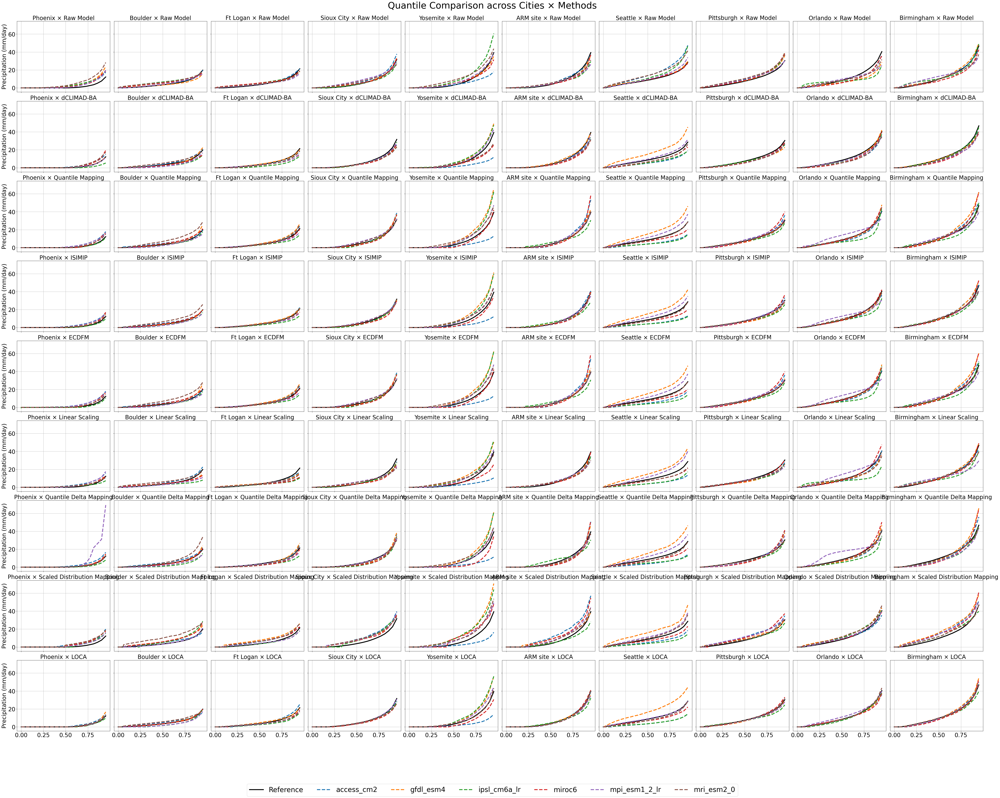

In [147]:
cmip6_models = ['access_cm2', 'gfdl_esm4', 'ipsl_cm6a_lr', 'miroc6', 'mpi_esm1_2_lr','mri_esm2_0']
city_names = list(cities.keys())
methods = {
    "Raw Model": quantile_x_local,
    "dCLIMAD-BA": quantile_xt_local,
    "Quantile Mapping": quantile_QM_local,
    "ISIMIP": quantile_ISIMIP_local,
    "ECDFM": quantile_ECDFM_local,
    "Linear Scaling": quantile_LS_local,
    "Quantile Delta Mapping": quantile_QDM_local,
    "Scaled Distribution Mapping": quantile_SDM_local,
    "LOCA": quantile_loca_local,

}

n_cities = len(city_names)
n_methods = len(methods)

fig, axes = plt.subplots(
    ncols=n_cities, nrows=n_methods,
    figsize=(6*n_cities, 5*n_methods),
    sharex=True, sharey=True
)

if n_cities == 1 and n_methods == 1:
    axes = [[axes]]
elif n_cities == 1:
    axes = [axes]
elif n_methods == 1:
    axes = [[ax] for ax in axes]

for i, city in enumerate(city_names):
    for j, (method_name, method_data) in enumerate(methods.items()):
        ax = axes[j][i]

        # Plot observed (thick black)
        ax.plot(
            quantiles**5,
            quantile_y_local[i].mean(axis=1),  # mean across models (can remove if not wanted)
            color="black", linewidth=4, label="Reference"
        )

        # Plot each CMIP6 model
        n_models = method_data[i].shape[1]
        for m in range(n_models):
            ax.plot(
                quantiles**5,
                method_data[i][:, m],
                linestyle="--", linewidth=4,
                label=cmip6_models[m] if (i == 0 and j == 0) else None
            )

        ax.set_title(f"{city} × {method_name}", fontsize=25)
        if j == n_cities - 1:
            ax.set_xlabel("Warped Quantiles (power 5)", fontsize=25)
        if i == 0:
            ax.set_ylabel("Precipitation (mm/day)", fontsize=25)
        ax.grid(True)
        ax.tick_params(axis='x', labelsize=25)
        ax.tick_params(axis='y', labelsize=25)

# Global legend at bottom
handles, labels = axes[0][0].get_legend_handles_labels()
fig.legend(
    handles, labels,
    loc="lower center", ncol=7,
    bbox_to_anchor=(0.5, -0.08), fontsize=30
)

fig.suptitle("Quantile Comparison across Cities × Methods", fontsize=40, y=1)
plt.tight_layout()
plt.savefig(f"{save_path}/Quantile_Comparison_Cities_x_Methods.png", bbox_inches='tight', dpi=300)
plt.show()


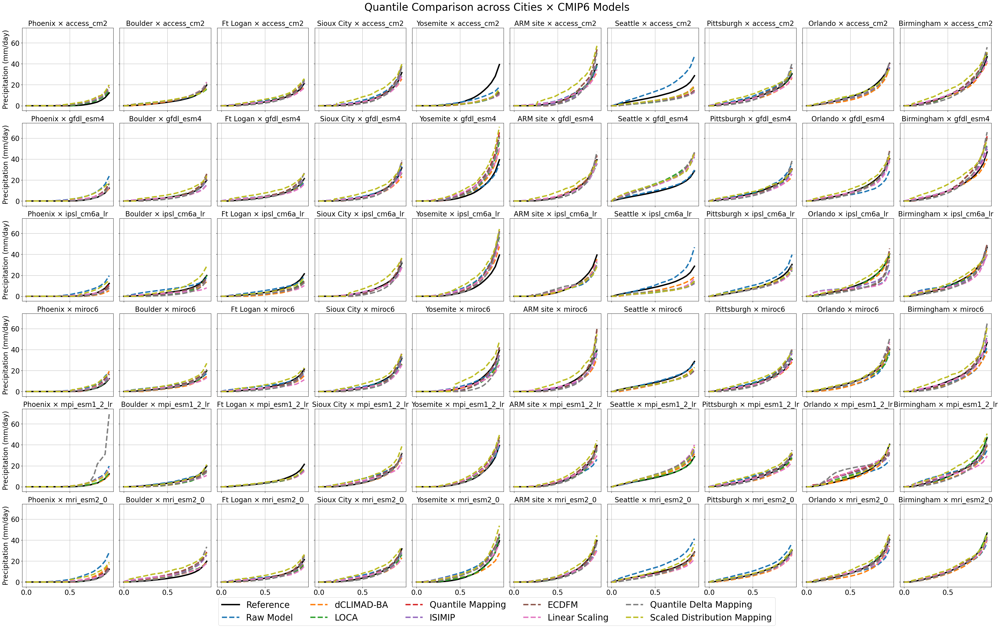

In [148]:
# Number of CMIP6 models = second dimension of quantile_x_local[i]
n_models = quantile_x_local[0].shape[1]

fig, axes = plt.subplots(
    ncols=n_cities, nrows=n_models,
    figsize=(4*n_cities, 4*n_models),
    sharex=True, sharey=True
)

if n_cities == 1 and n_models == 1:
    axes = [[axes]]
elif n_cities == 1:
    axes = [axes]
elif n_models == 1:
    axes = [[ax] for ax in axes]

for i, city in enumerate(city_names):
    for m in range(n_models):
        ax = axes[m][i]

        # Observed curve
        ax.plot(
            quantiles**5,
            quantile_y_local[i].mean(axis=1),
            color="black", linewidth=4, label="Reference"
        )

        # Raw model curve
        ax.plot(
            quantiles**5,
            quantile_x_local[i][:, m],
            linestyle="--", linewidth=4, label="Raw Model"
        )

        ax.plot(
            quantiles**5,
            quantile_xt_local[i][:, m],
            linestyle="--", linewidth=4, label="dCLIMAD-BA"
        )

        ax.plot(
            quantiles**5,
            quantile_loca_local[i][:, m],
            linestyle="--", linewidth=4, label="LOCA"
        )

        ax.plot(
            quantiles**5,
            quantile_QM_local[i][:, m],
            linestyle="--", linewidth=4, label="Quantile Mapping"
        )

        ax.plot(
            quantiles**5,
            quantile_ISIMIP_local[i][:, m],
            linestyle="--", linewidth=4, label="ISIMIP"
        )

        ax.plot(
            quantiles**5,
            quantile_ECDFM_local[i][:, m],
            linestyle="--", linewidth=4, label="ECDFM"
        )

        ax.plot(
            quantiles**5,
            quantile_LS_local[i][:, m],
            linestyle="--", linewidth=4, label="Linear Scaling"
        )

        ax.plot(
            quantiles**5,
            quantile_QDM_local[i][:, m],
            linestyle="--", linewidth=4, label="Quantile Delta Mapping"
        )

        ax.plot(
            quantiles**5,
            quantile_SDM_local[i][:, m],
            linestyle="--", linewidth=4, label="Scaled Distribution Mapping"
        )

        ax.set_title(f"{city} × {cmip6_models[m]}", fontsize=20)
        if m == n_cities - 1:
            ax.set_xlabel("Quantiles", fontsize=20)
        if i == 0:
            ax.set_ylabel("Precipitation (mm/day)", fontsize=20)
        ax.grid(True)
        ax.tick_params(axis='x', labelsize=20)
        ax.tick_params(axis='y', labelsize=20)
        # ax.set_yscale('log')
        # ax.set_xscale('log')



# Global legend
handles, labels = axes[0][0].get_legend_handles_labels()
fig.legend(
    handles, labels,
    loc="lower center", ncol=5,
    bbox_to_anchor=(0.5, -0.05), fontsize=25
)

fig.suptitle("Quantile Comparison across Cities × CMIP6 Models", fontsize=30, y=1)
plt.tight_layout()
plt.savefig(f'{save_path}/Quantile_Cities_x_CMIP6_Models.png', bbox_inches='tight', dpi=300)
plt.show()


In [38]:
annual_total_x_local = []
annual_total_xt_local = []
annual_total_y_local = []
annual_total_loca_local = []
annual_total_QM_local = []

for i in range(len(cities)):
    annual_total_x = []
    annual_total_y = []
    annual_total_xt = []
    annual_total_loca = []
    annual_total_QM = []

    for j in range(len(models)):
        loc = city_index[j][0][i]

        annual_total_x.append(calculate_annual_total(models[j]['x'], models[j]['x_time_np'])[:,loc])
        annual_total_y.append(calculate_annual_total(models[j]['y'], models[j]['x_time_np'])[:,loc])
        annual_total_xt.append(calculate_annual_total(models[j]['xt'], models[j]['x_time_np'])[:,loc])
        annual_total_loca.append(calculate_annual_total(loca_all[j], models[j]['x_time_np'])[:,loc])
        annual_total_QM.append(calculate_annual_total(QM_all[j], models[j]['x_time_np'])[:,loc])


    annual_total_x_local.append(np.array(annual_total_x).T)
    annual_total_xt_local.append(np.array(annual_total_xt).T)
    annual_total_y_local.append(np.array(annual_total_y).T)
    annual_total_loca_local.append(np.array(annual_total_loca).T)
    annual_total_QM_local.append(np.array(annual_total_QM).T)





In [ ]:


def plot_raw_and_multiple_bc_side_by_side(obs_list, raw_list, location_names, *bc_models, bc_labels=None, indice = 'Annual Precipitation (mm)'):
    """
    Enhanced version with larger fonts.
    - obs_list: list of (n_years,) or (n_years, 1)
    - raw_list: list of (n_years, n_models)
    - *bc_models: any number of bias corrected model lists (each list shaped like raw_list)
    - bc_labels: optional list of names for the BC methods (default: BC1, BC2, etc.)
    """
    n_locations = len(location_names)
    n_bc = len(bc_models)
    total_cols = 1 + n_bc  # 1 RAW + n bias-corrected

    # Default labels
    if bc_labels is None:
        bc_labels = [f"BC{i+1}" for i in range(n_bc)]

    # Font sizes
    title_font = 14+4
    axis_font = 12+4
    tick_font = 10+4
    legend_font = 10+4
    pdf_title_font = 11+4

    fig, axs = plt.subplots(n_locations, total_cols, figsize=(6 * total_cols, 4.5 * n_locations), constrained_layout=True)
    if n_locations == 1:
        axs = axs[np.newaxis, :]  # Ensure 2D shape for consistency

    for i in range(n_locations):
        obs = obs_list[i][:, 0] if obs_list[i].ndim == 2 else obs_list[i]
        raw = raw_list[i]
        years = np.arange(len(obs))

        # RAW Column (always first)
        ax_raw = axs[i, 0]
        raw_mean = raw.mean(axis=1)
        raw_std = raw.std(axis=1)

        ax_raw.plot(years, obs, color='black', label='Obs')
        ax_raw.plot(years, raw_mean, color='gray', label='RAW-MM')
        raw_min = raw.min(axis=1)
        raw_max = raw.max(axis=1)
        ax_raw.fill_between(years, raw_min, raw_max, color='gray', alpha=0.3, label='RAW')
    
        ax_raw.set_title(f"{location_names[i]} – RAW", fontsize=title_font)
        ax_raw.set_xlabel("Year", fontsize=axis_font)
        ax_raw.set_ylabel(indice, fontsize=axis_font)
        ax_raw.tick_params(labelsize=tick_font)
        ax_raw.grid(True, alpha=0.3)
        ax_raw.legend(fontsize=legend_font, loc='lower right')

        inset_raw = ax_raw.inset_axes([0.58, 0.52, 0.38, 0.38])
        kde_obs = gaussian_kde(obs)
        kde_raw = gaussian_kde(raw.flatten())
        xs = np.linspace(min(obs.min(), raw.min()), max(obs.max(), raw.max()), 200)
        inset_raw.plot(xs, kde_obs(xs), color='black')
        inset_raw.plot(xs, kde_raw(xs), color='gray')
        inset_raw.set_xticks([])
        inset_raw.set_yticks([])
        inset_raw.set_title("PDF", fontsize=pdf_title_font)

        # Bias-corrected columns
        for j, bc_list in enumerate(bc_models):
            bc = bc_list[i]
            bc_mean = bc.mean(axis=1)
            bc_std = bc.std(axis=1)

            ax = axs[i, j + 1]
            ax.plot(years, obs, color='black', label='Obs')
            ax.plot(years, bc_mean, label=f'{bc_labels[j]}-MM')
            bc_min = bc.min(axis=1)
            bc_max = bc.max(axis=1)
            ax.fill_between(years, bc_min, bc_max, alpha=0.3, label=f"{bc_labels[j]}")
            ax.set_title(f"{location_names[i]} – {bc_labels[j]}", fontsize=title_font)
            ax.set_xlabel("Year", fontsize=axis_font)
            ax.set_ylabel(indice, fontsize=axis_font)
            ax.tick_params(labelsize=tick_font)
            ax.grid(True, alpha=0.3)
            ax.legend(fontsize=legend_font, loc='lower left')

            inset = ax.inset_axes([0.58, 0.52, 0.38, 0.38])
            kde_bc = gaussian_kde(bc.flatten())
            xs_all = np.linspace(min(obs.min(), bc.min()), max(obs.max(), bc.max()), 200)
            inset.plot(xs_all, kde_obs(xs_all), color='black')
            inset.plot(xs_all, kde_bc(xs_all))
            inset.set_xticks([])
            inset.set_yticks([])
            inset.set_title("PDF", fontsize=pdf_title_font)

    fig.suptitle("RAW and Bias-Corrected Models vs Observations", fontsize=title_font + 2)
    base = f'{save_path}annualtotalP1.png'
    filename = base
    i = 1
    while os.path.exists(filename):
        filename = f'{save_path}annualtotalP1_{i}.png'
        i += 1
    plt.savefig(filename)
    plt.show()


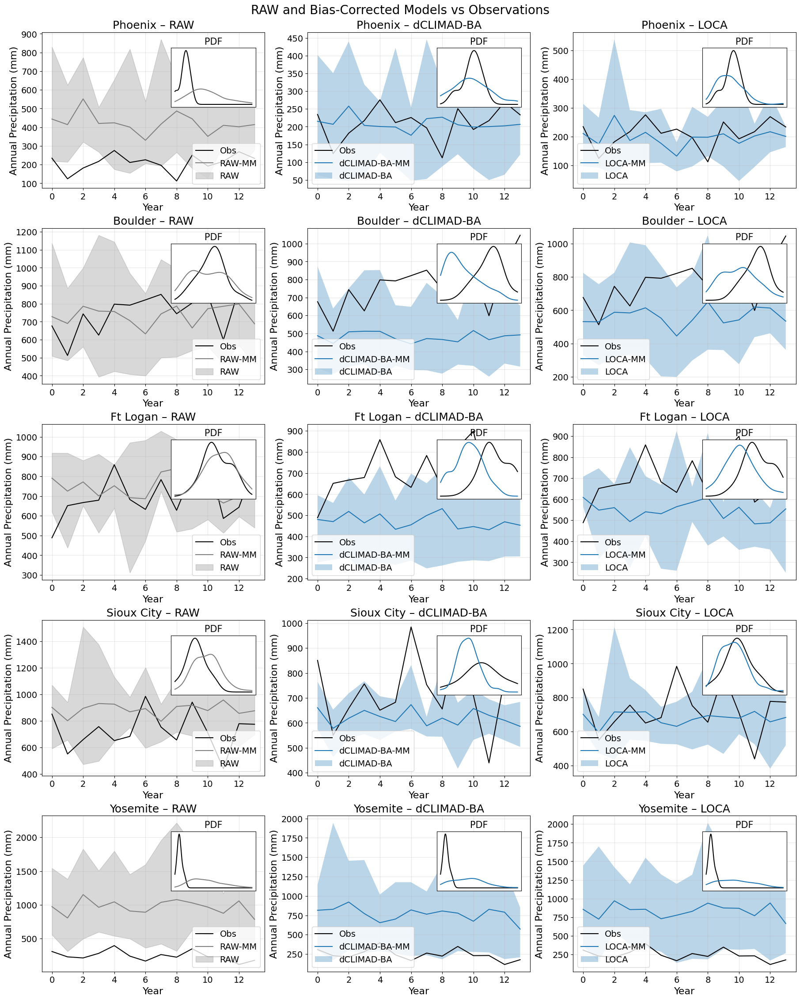

In [41]:
plot_raw_and_multiple_bc_side_by_side(annual_total_y_local[:5], annual_total_x_local[:5], list(cities.keys())[:5], annual_total_xt_local[:5], annual_total_loca_local[:5],  bc_labels=["dCLIMAD-BA", "LOCA"])

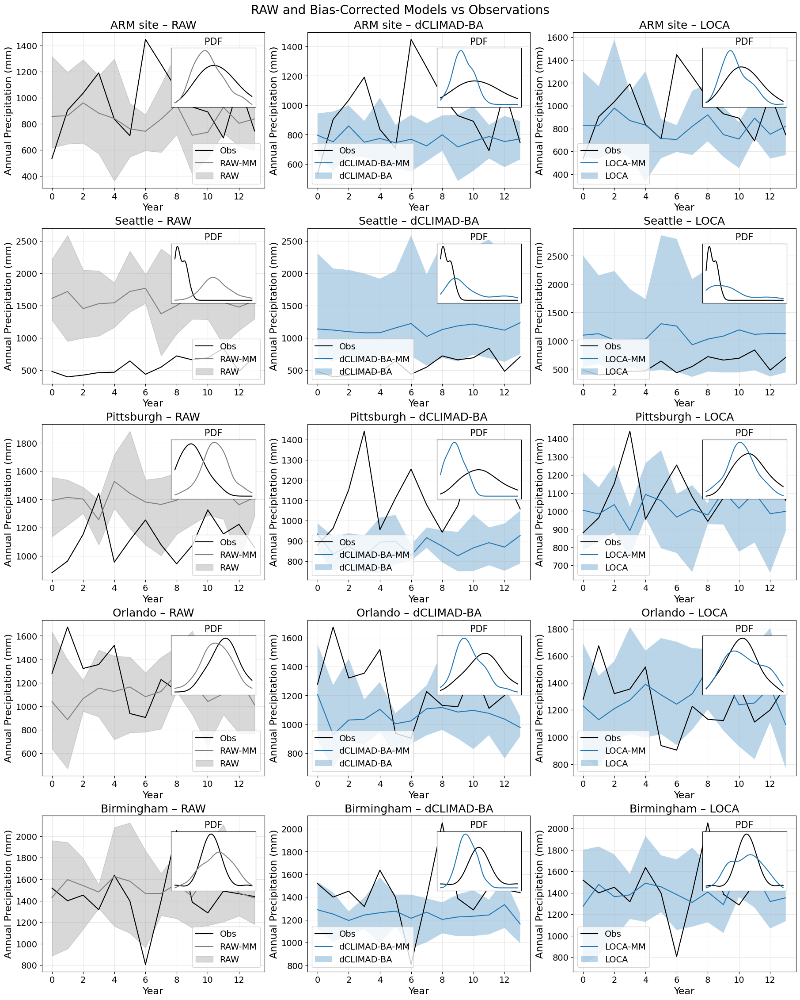

In [42]:
plot_raw_and_multiple_bc_side_by_side(annual_total_y_local[5:], annual_total_x_local[5:], list(cities.keys())[5:], annual_total_xt_local[5:], annual_total_loca_local[5:],  bc_labels=["dCLIMAD-BA", "LOCA"])

In [43]:
def plot_qq_city_method_grid(
    obs_city_list,
    raw_city_list,
    bc_city_lists,
    city_names,
    bc_labels=None,
    bc_colors=None,
    figsize_per_panel=(4, 4)
):
    """
    Creates a grid of Q-Q plots:
    - Rows = RAW + BC methods
    - Columns = Cities
    Each subplot = Q-Q plot of a method (row) for a city (column)
    
    Inputs:
    - obs_city_list: list of (n_years,) arrays
    - raw_city_list: list of (n_years, n_models) arrays
    - bc_city_lists: list of N methods → each is list of (n_years, n_models) arrays (1 per city)
    - city_names: list of city names
    - bc_labels: list of bias correction method names
    - bc_colors: list of colors
    - figsize_per_panel: tuple (width, height) per subplot
    """

    n_cities = len(city_names)
    n_methods = len(bc_city_lists)
    all_labels = ["RAW"] + (bc_labels if bc_labels else [f"BC{i+1}" for i in range(n_methods)])
    all_colors = ["gray"] + (bc_colors if bc_colors else ['teal', 'indianred', 'purple', 'orange'][:n_methods])

    nrows = 1 + n_methods
    ncols = n_cities

    fig, axs = plt.subplots(nrows, ncols, figsize=(figsize_per_panel[0] * ncols, figsize_per_panel[1] * nrows), constrained_layout=True)

    # Always 2D array of axes
    if nrows == 1:
        axs = axs[np.newaxis, :]
    if ncols == 1:
        axs = axs[:, np.newaxis]

    for city_idx in range(n_cities):
        obs = obs_city_list[city_idx][:,0]
        raw = raw_city_list[city_idx]
        bc_for_city = [bc[city_idx] for bc in bc_city_lists]

        data_group = [("RAW", raw, all_colors[0])] + \
                     list(zip(bc_labels, bc_for_city, all_colors[1:]))

        for row_idx, (label, data, color) in enumerate(data_group):
            ax = axs[row_idx, city_idx]
            for model in data.T:
                n = min(len(obs), len(model))
                ax.plot(np.sort(obs)[:n], np.sort(model)[:n], alpha=0.3, color=color)

            # 1:1 line
            ax.plot([obs.min(), obs.max()], [obs.min(), obs.max()], 'k--', linewidth=1)

            if row_idx == 0:
                ax.set_title(city_names[city_idx], fontsize=13)

            if city_idx == 0:
                ax.set_ylabel(f"{label}", fontsize=12)
            else:
                ax.set_yticks([])

            if row_idx == nrows - 1:
                ax.set_xlabel("Observed", fontsize=11)
            else:
                ax.set_xticks([])

            ax.grid(True, linestyle="--", alpha=0.4)

    fig.suptitle("Q-Q Grid: Cities vs Methods", fontsize=16)
    plt.savefig(f'{save_path}annualtotalP1_QQ.png')

    plt.show()


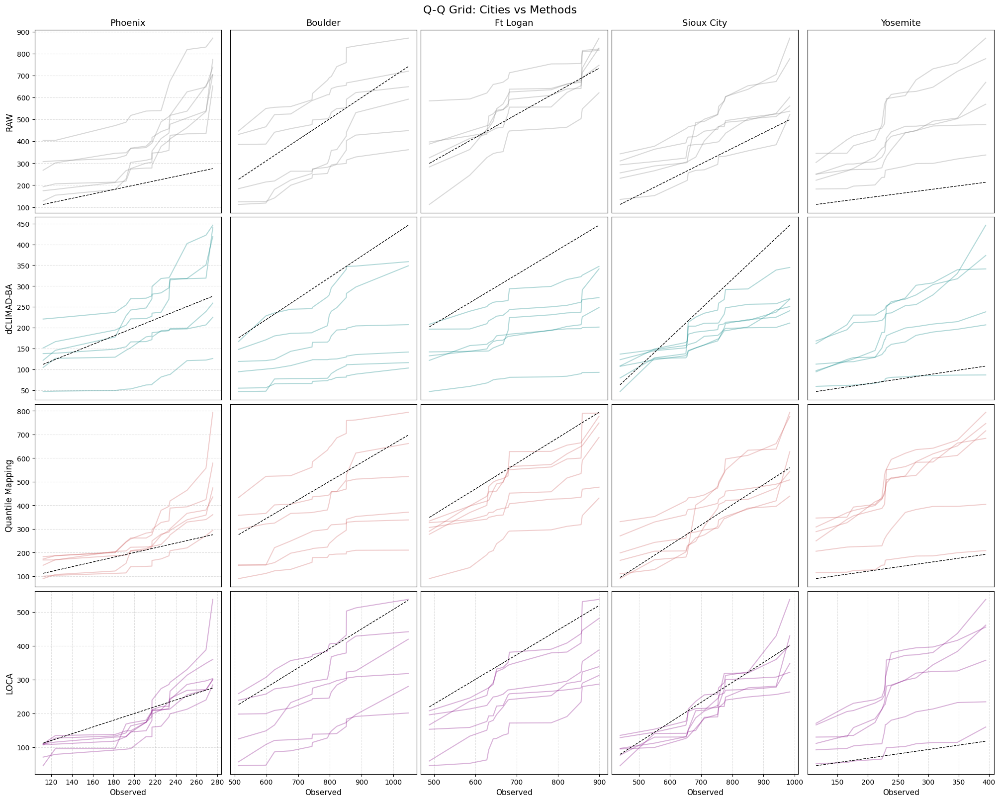

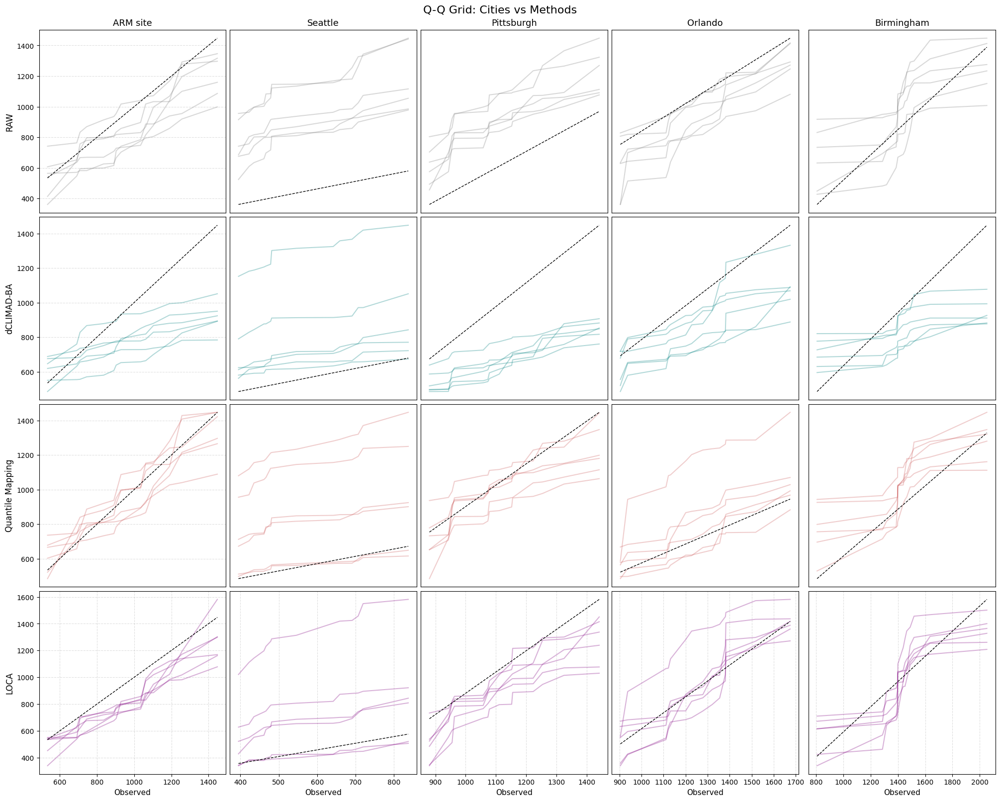

In [44]:
plot_qq_city_method_grid(annual_total_y_local[:5], annual_total_x_local[:5], [annual_total_xt_local[:5], annual_total_QM_local[:5], annual_total_loca_local[:5]],
                          city_names= list(cities.keys())[:5], bc_labels=["dCLIMAD-BA", "Quantile Mapping", "LOCA"])
plot_qq_city_method_grid(annual_total_y_local[5:], annual_total_x_local[5:], [annual_total_xt_local[5:], annual_total_QM_local[5:], annual_total_loca_local[5:]],
                          city_names= list(cities.keys())[5:], bc_labels=["dCLIMAD-BA", "Quantile Mapping", "LOCA"])


### Precipitation Indices - Ensemble

In [149]:
interp_coords = []
ensemble_coords = valid_coords[2]
for coords in valid_coords:
    interp_coords.append(find_nearest_indices(ensemble_coords, coords))

In [150]:


# Initialize climate indices manager
climate_indices = ClimateIndices()

thresholds = climate_indices.get_indices()

x_ensemble_indices = {}
# y_ensemble_indices = {}
xt_ensemble_indices = {}
loca_ensemble_indices = {}
QM_ensemble_indices = {}
ISIMIP_ensemble_indices = {}
SDM_ensemble_indices = {}
ECDFM_ensemble_indices = {}
LS_ensemble_indices = {}
QDM_ensemble_indices = {}
SDM_ensemble_indices = {}

counter = 0 
for model in models:

    for label, (threshold, comparison) in thresholds.items():
        if callable(threshold):  # If function, apply it to y
            model[f'{label}_x'] = threshold(model['x_time_np'], model['x'])
            model[f'{label}_y'] = threshold(model['x_time_np'], model['y'])
            model[f'{label}_xt'] = threshold(model['x_time_np'], model['xt'])
            model[f'{label}_loca'] = threshold(model['x_time_np'], loca_all[counter])
            model[f'{label}_QM'] = threshold(model['x_time_np'], QM_all[counter])
            model[f'{label}_ISIMIP'] = threshold(model['x_time_np'], ISIMIP_all[counter])
            model[f'{label}_ECDFM'] = threshold(model['x_time_np'], ECDFM_all[counter])
            model[f'{label}_SDM'] = threshold(model['x_time_np'], SDM_all[counter])
            model[f'{label}_LS'] = threshold(model['x_time_np'], LS_all[counter])
            model[f'{label}_QDM'] = threshold(model['x_time_np'], QDM_all[counter])

            if label not in x_ensemble_indices:
                x_ensemble_indices[label] = model[f'{label}_x'][:, interp_coords[counter][0]]/len(models)
                # y_ensemble_indices[label] = model[f'{label}_y'][:, interp_coords[counter][0]]
                xt_ensemble_indices[label] = model[f'{label}_xt'][:, interp_coords[counter][0]]/len(models)
                loca_ensemble_indices[label] = model[f'{label}_loca'][:, interp_coords[counter][0]]/len(models)
                QM_ensemble_indices[label] = model[f'{label}_QM'][:, interp_coords[counter][0]]/len(models)
                ISIMIP_ensemble_indices[label] = model[f'{label}_ISIMIP'][:, interp_coords[counter][0]]/len(models)
                ECDFM_ensemble_indices[label] = model[f'{label}_ECDFM'][:, interp_coords[counter][0]]/len(models)
                LS_ensemble_indices[label] = model[f'{label}_LS'][:, interp_coords[counter][0]]/len(models)
                QDM_ensemble_indices[label] = model[f'{label}_QDM'][:, interp_coords[counter][0]]/len(models)
                SDM_ensemble_indices[label] = model[f'{label}_SDM'][:, interp_coords[counter][0]]/len(models)
            else:
                x_ensemble_indices[label]+= model[f'{label}_x'][:, interp_coords[counter][0]]/len(models)
                xt_ensemble_indices[label]+= model[f'{label}_xt'][:, interp_coords[counter][0]]/len(models)
                loca_ensemble_indices[label]+= model[f'{label}_loca'][:, interp_coords[counter][0]]/len(models)
                QM_ensemble_indices[label]+= model[f'{label}_QM'][:, interp_coords[counter][0]]/len(models)
                ISIMIP_ensemble_indices[label]+= model[f'{label}_ISIMIP'][:, interp_coords[counter][0]]/len(models)
                ECDFM_ensemble_indices[label]+= model[f'{label}_ECDFM'][:, interp_coords[counter][0]]/len(models)
                LS_ensemble_indices[label]+= model[f'{label}_LS'][:, interp_coords[counter][0]]/len(models)
                QDM_ensemble_indices[label]+= model[f'{label}_QDM'][:, interp_coords[counter][0]]/len(models)
                SDM_ensemble_indices[label]+= model[f'{label}_SDM'][:, interp_coords[counter][0]]/len(models)
    counter+=1
    

In [155]:
bias_dict = {}

for label, (threshold, comparison) in thresholds.items():
    y_ensemble_indices = models[2]
    if callable(threshold):
        xt_bias = compute_mean_bias_percentage(None, x_ensemble_indices[label], y_ensemble_indices[f'{label}_y'], xt_ensemble_indices[label])
        loca_bias = compute_mean_bias_percentage(None, x_ensemble_indices[label], y_ensemble_indices[f'{label}_y'], loca_ensemble_indices[label])
        QM_bias = compute_mean_bias_percentage(None, x_ensemble_indices[label], y_ensemble_indices[f'{label}_y'], QM_ensemble_indices[label])
        ISIMIP_bias = compute_mean_bias_percentage(None, x_ensemble_indices[label], y_ensemble_indices[f'{label}_y'], ISIMIP_ensemble_indices[label])
        ECDFM_bias = compute_mean_bias_percentage(None, x_ensemble_indices[label], y_ensemble_indices[f'{label}_y'], ECDFM_ensemble_indices[label])
        LS_bias = compute_mean_bias_percentage(None, x_ensemble_indices[label], y_ensemble_indices[f'{label}_y'], LS_ensemble_indices[label])
        QDM_bias = compute_mean_bias_percentage(None, x_ensemble_indices[label], y_ensemble_indices[f'{label}_y'], QDM_ensemble_indices[label])
        SDM_bias = compute_mean_bias_percentage(None, x_ensemble_indices[label], y_ensemble_indices[f'{label}_y'], SDM_ensemble_indices[label])

        bias_dict[label] = (xt_bias[0], xt_bias[1], QM_bias[1], ISIMIP_bias[1], ECDFM_bias[1], LS_bias[1], QDM_bias[1], SDM_bias[1], loca_bias[1])

## add another key to the bias dict, which is average of all the previous keys for xt, loca and QM
x_avg = np.nanmean([bias[0] for bias in bias_dict.values()], axis=0)
xt_avg = np.nanmean([bias[1] for bias in bias_dict.values()], axis=0)
QM_avg = np.nanmean([bias[2] for bias in bias_dict.values()], axis=0)
ISIMIP_avg = np.nanmean([bias[3] for bias in bias_dict.values()], axis=0)
ECDFM_avg = np.nanmean([bias[4] for bias in bias_dict.values()], axis=0)
LS_avg = np.nanmean([bias[5] for bias in bias_dict.values()], axis=0)
QDM_avg = np.nanmean([bias[6] for bias in bias_dict.values()], axis=0)
SDM_avg = np.nanmean([bias[7] for bias in bias_dict.values()], axis=0)
loca_avg = np.nanmean([bias[8] for bias in bias_dict.values()], axis=0)

bias_dict['Average'] = (x_avg, xt_avg,  QM_avg, ISIMIP_avg, ECDFM_avg, LS_avg, QDM_avg, SDM_avg, loca_avg)


/pscratch/sd/k/kas7897/dCLIMAD_BA/eval/metrics.py:190: RuntimeWarning: Mean of empty slice
  percent_bias_x = np.nanmean(bias_x, axis=0)  # shape: (n_grid,)
/pscratch/sd/k/kas7897/dCLIMAD_BA/eval/metrics.py:191: RuntimeWarning: Mean of empty slice
  percent_bias_xt = np.nanmean(bias_xt, axis=0)


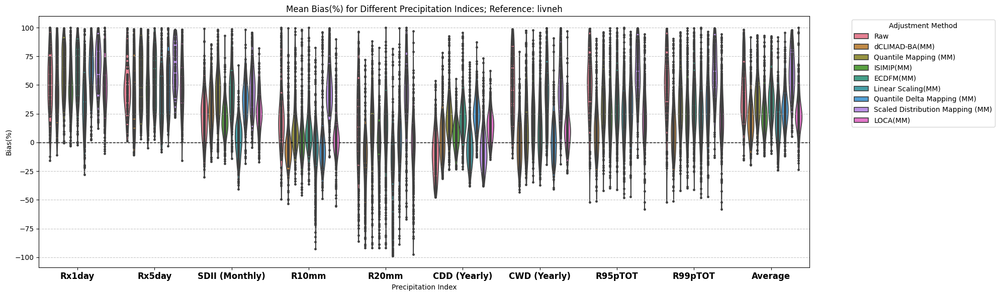

In [156]:
keys = ['SDII (Monthly)','CDD (Yearly)', 'CWD (Yearly)', "Rx1day", "Rx5day", "R10mm",  "R20mm", "R95pTOT", "R99pTOT", 'Average']
d = dict(filter(lambda item: item[0] in keys , bias_dict.items()))



# Create a 2x2 subplot figure
fig, axes = plt.subplots(1, 1, figsize=(20, 6), sharey=True)


ref_label = models[0]['config']['ref']
method_names = ['dCLIMAD-BA(MM)','Quantile Mapping (MM)', 'ISIMIP(MM)', 'ECDFM(MM)', 'Linear Scaling(MM)', 
                'Quantile Delta Mapping (MM)', 'Scaled Distribution Mapping (MM)', 'LOCA(MM)', ] 
# Call the function for each dataset
plot_violin_bias(axes, d, "Bias(%)", f"Mean Bias(%) for Different Precipitation Indices; Reference: {ref_label}",  method_names=method_names, remove_outlier=True)

# plot_violin_bias(axes[1], d4, "Bias(%)", "Day Bias(%) for Different Precipitation Indices",  method_names=method_names, remove_outlier=True)
# fig.suptitle(f'Ensemble-Livneh', fontsize=20, fontweight="bold", y=1.02)


plt.tight_layout()
plt.savefig(f'{save_path}violin_Pindices.png')

plt.show()

/pscratch/sd/k/kas7897/dCLIMAD_BA/eval/plot.py:156: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.86, 0.95])


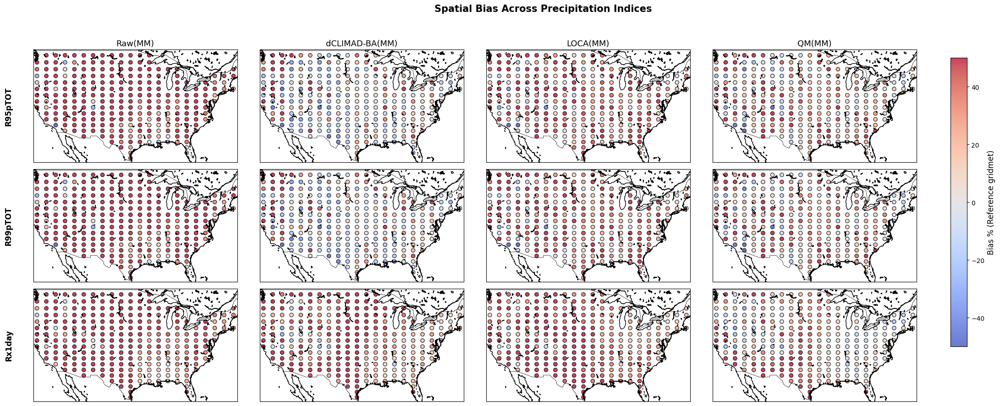

/pscratch/sd/k/kas7897/dCLIMAD_BA/eval/plot.py:156: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.86, 0.95])


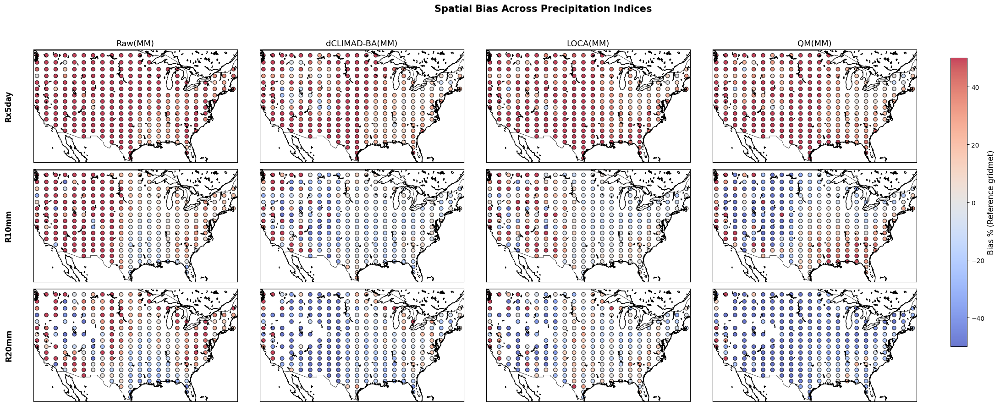

/pscratch/sd/k/kas7897/dCLIMAD_BA/eval/plot.py:156: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.86, 0.95])


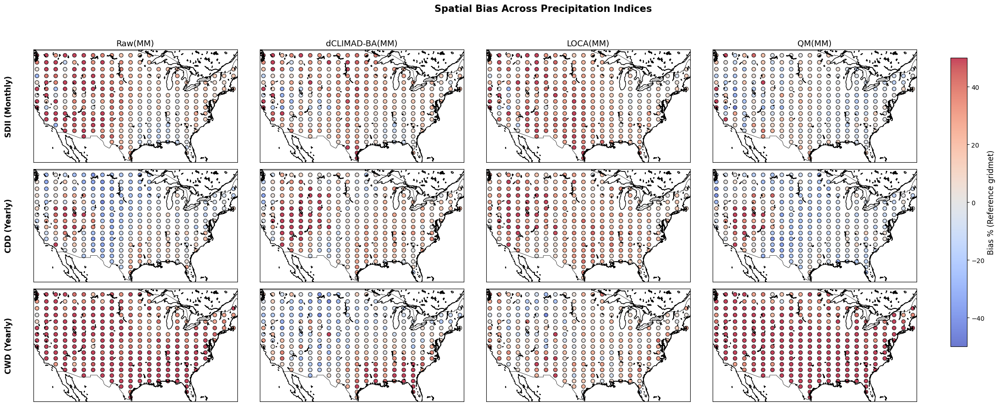

In [17]:
analyze_indice = [['R95pTOT', 'R99pTOT', 'Rx1day'], ['Rx5day', 'R10mm', 'R20mm'], ['SDII (Monthly)', 'CDD (Yearly)', 'CWD (Yearly)']]
method_names = ['Raw(MM)','dCLIMAD-BA(MM)', 'LOCA(MM)', 'QM(MM)'] 


for indice_list in analyze_indice:
    plot_spatial_bias(valid_coords=valid_coords[2],
                            bias_data_dict=bias_dict,
                            threshold_types=indice_list,
                            label=f"Bias % (Reference {models[2]['config']['ref']})",
                            method_names=method_names,
                            vmin=-50,
                            vmax=50,
                            cmap='coolwarm')

/pscratch/sd/k/kas7897/diffDownscale/eval/plot.py:156: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.86, 0.95])


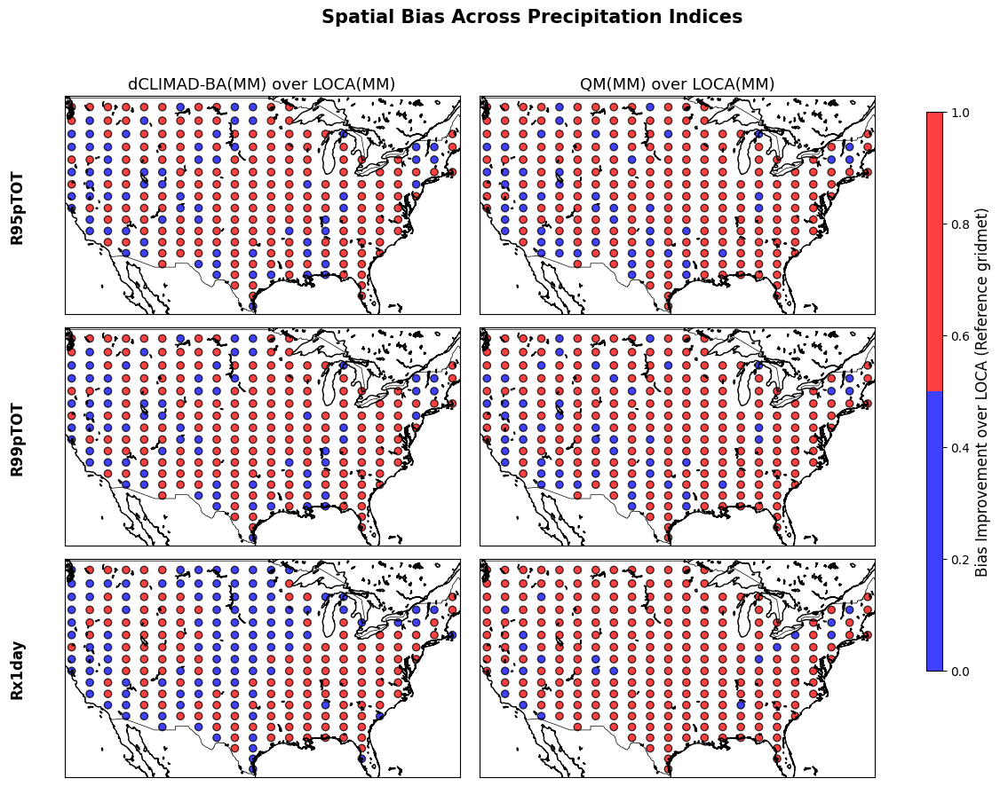

/pscratch/sd/k/kas7897/diffDownscale/eval/plot.py:156: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.86, 0.95])


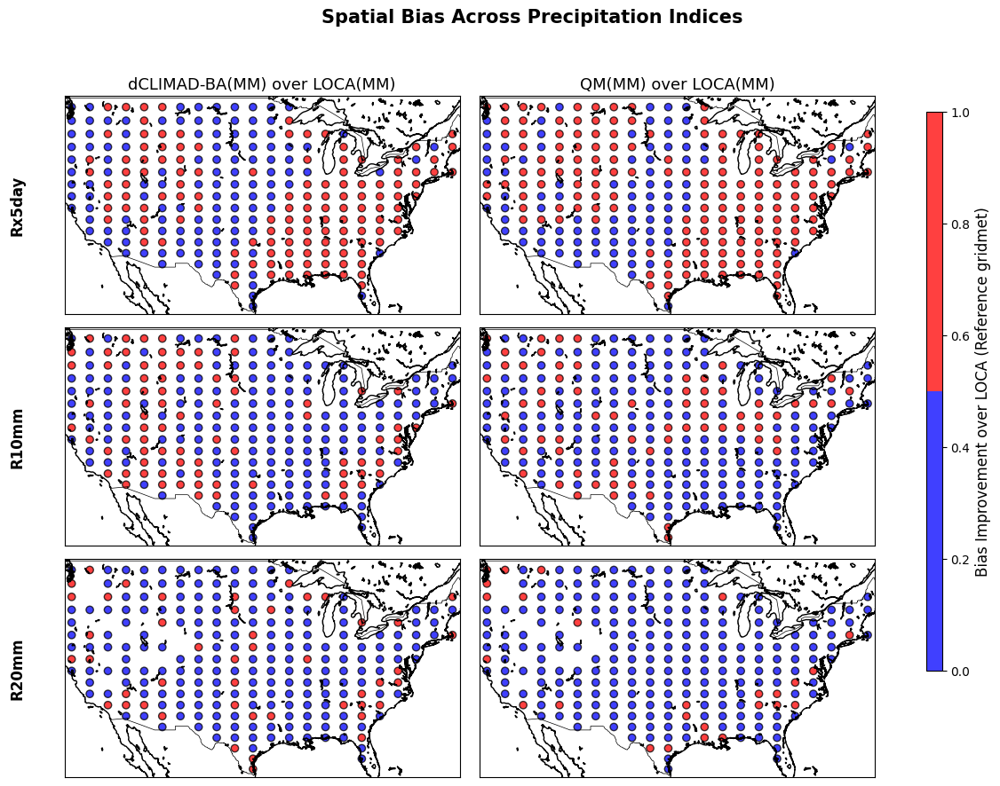

/pscratch/sd/k/kas7897/diffDownscale/eval/plot.py:156: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.86, 0.95])


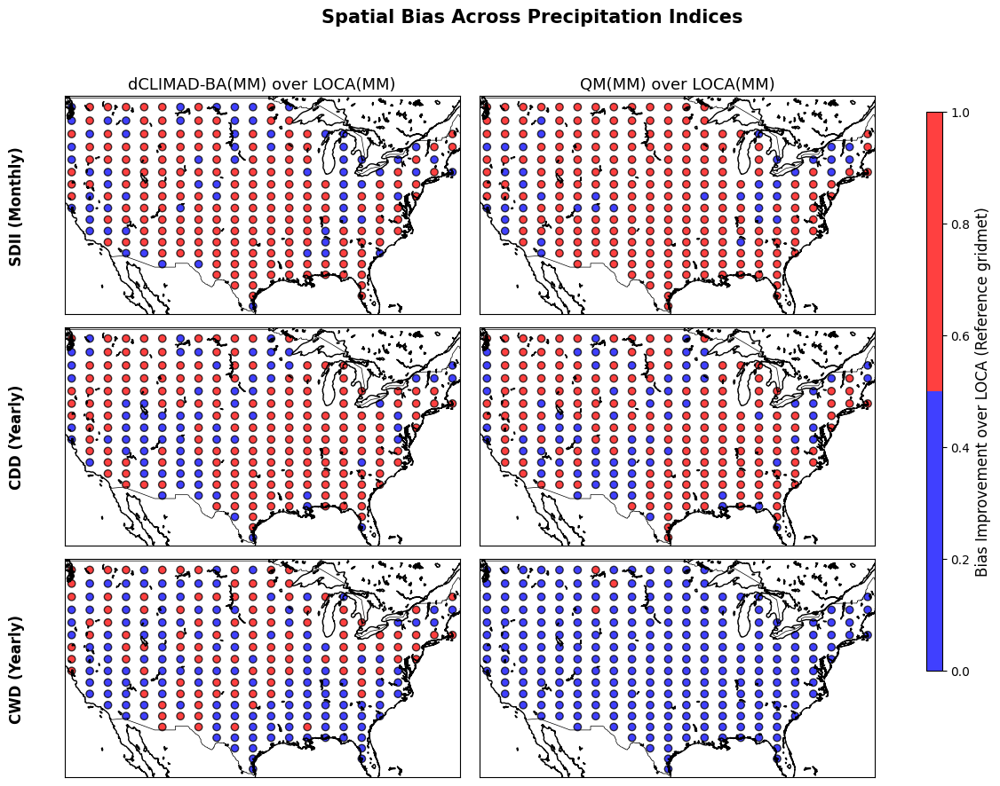

In [19]:
method_names = ['dCLIMAD-BA(MM) over LOCA(MM)', 'QM(MM) over LOCA(MM)'] 

for indice_list in analyze_indice:
    improvement = {}


    for i in indice_list:
        x_improvement = abs(bias_dict[i][2]) - abs(bias_dict[i][0])

        xt_improvement = abs(bias_dict[i][2]) - abs(bias_dict[i][1])
        loca_improvement = abs(bias_dict[i][2]) - abs(bias_dict[i][2])
        QM_improvement = abs(bias_dict[i][2]) - abs(bias_dict[i][3])

        xt_improvement[xt_improvement>=0] = 1
        xt_improvement[xt_improvement<0] = 0

        loca_improvement[loca_improvement>=0] = 1
        loca_improvement[loca_improvement<0] = 0

        QM_improvement[QM_improvement>=0] = 1
        QM_improvement[QM_improvement<0] = 0



        # improvement[i] = (xt_improvement, loca_improvement, QM_improvement)
        improvement[i] = (xt_improvement, QM_improvement)

    binary_cmap = ListedColormap(['blue', 'red'])

    plot_spatial_bias(valid_coords=valid_coords[2],
                            bias_data_dict=improvement,
                            threshold_types=indice_list,
                            label=f"Bias Improvement over LOCA (Reference {models[2]['config']['ref']})",
                            method_names=method_names,
                            vmin=0,
                            vmax=1,
                            cmap=binary_cmap)


/pscratch/sd/k/kas7897/dCLIMAD_BA/eval/plot.py:156: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.86, 0.95])


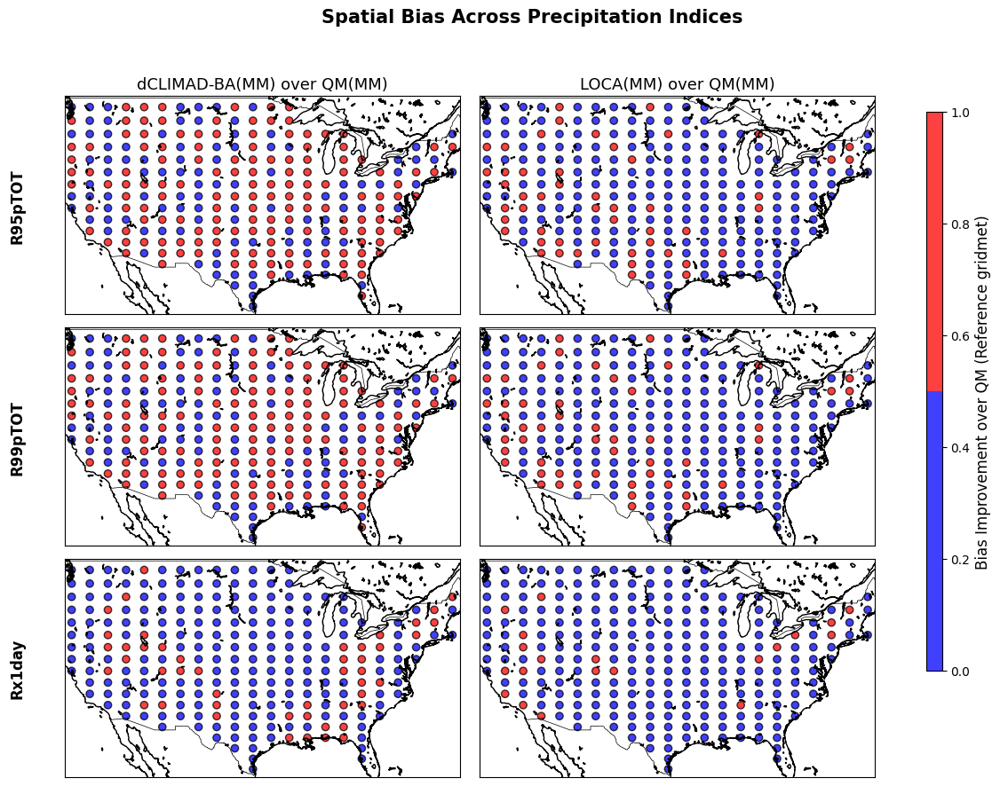

/pscratch/sd/k/kas7897/dCLIMAD_BA/eval/plot.py:156: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.86, 0.95])


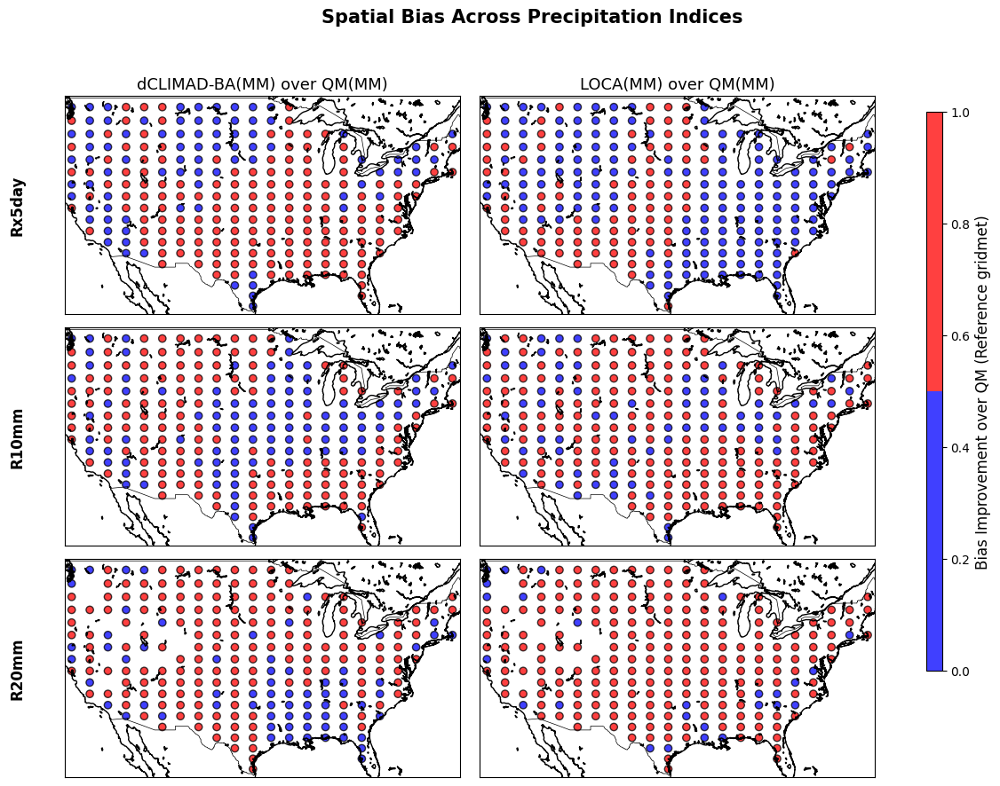

/pscratch/sd/k/kas7897/dCLIMAD_BA/eval/plot.py:156: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.86, 0.95])


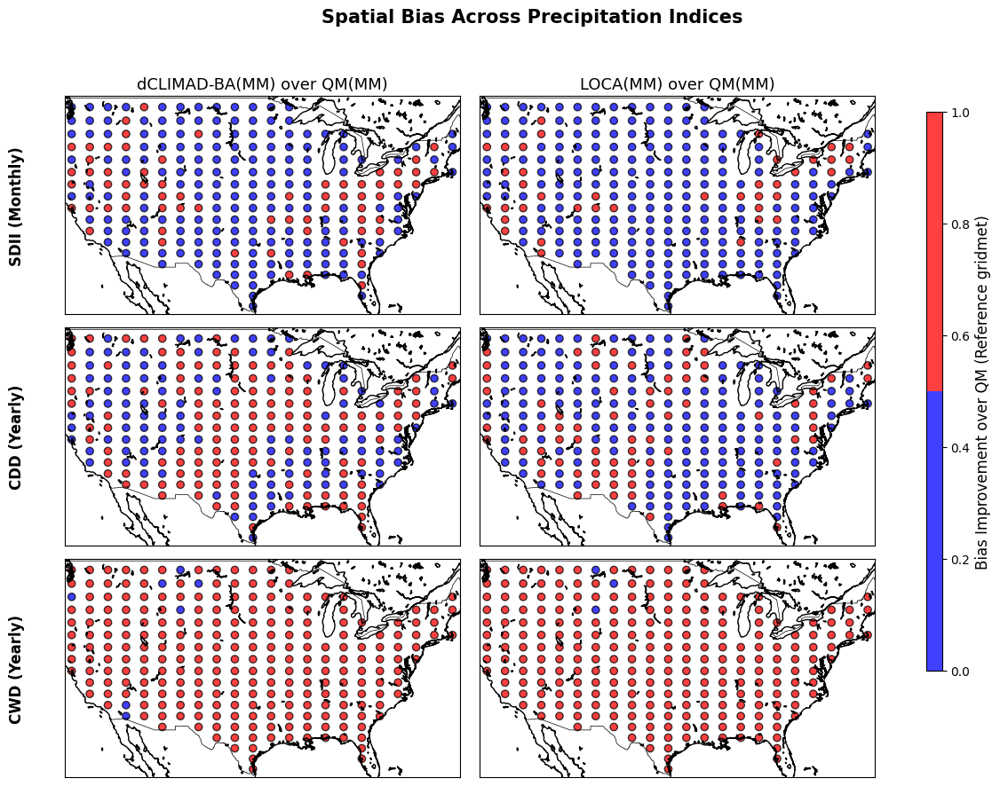

In [24]:

method_names = ['dCLIMAD-BA(MM) over QM(MM)', 'LOCA(MM) over QM(MM)'] 
for indice_list in analyze_indice:
    improvement = {}

    for i in indice_list:
        x_improvement = abs(bias_dict[i][3]) - abs(bias_dict[i][0])

        xt_improvement = abs(bias_dict[i][3]) - abs(bias_dict[i][1])
        loca_improvement = abs(bias_dict[i][3]) - abs(bias_dict[i][2])
        QM_improvement = abs(bias_dict[i][3]) - abs(bias_dict[i][3])

        xt_improvement[xt_improvement>=0] = 1
        xt_improvement[xt_improvement<0] = 0

        loca_improvement[loca_improvement>=0] = 1
        loca_improvement[loca_improvement<0] = 0

        QM_improvement[QM_improvement>=0] = 1
        QM_improvement[QM_improvement<0] = 0



        # improvement[i] = (xt_improvement, loca_improvement, QM_improvement)
        improvement[i] = (xt_improvement, loca_improvement)

    binary_cmap = ListedColormap(['blue', 'red'])

    plot_spatial_bias(valid_coords=valid_coords[2],
                            bias_data_dict=improvement,
                            threshold_types=indice_list,
                            label=f"Bias Improvement over QM (Reference {models[2]['config']['ref']})",
                            method_names=method_names,
                            vmin=0,
                            vmax=1,
                            cmap=binary_cmap)


In [ ]:
analyze_indice = 'Rx1day'


indices_x_local = []
indices_xt_local = []
indices_y_local = []
indices_loca_local = []
indices_QM_local = []

for i in range(len(cities)):
    indices_x = []
    indices_y = []
    indices_xt = []
    indices_loca = []
    indices_QM = []

    for j in range(len(models)):
        loc = city_index[j][0][i]

        indices_x.append(models[j][f'{analyze_indice}_x'][:,loc])
        indices_y.append(models[j][f'{analyze_indice}_y'][:,loc])
        indices_xt.append(models[j][f'{analyze_indice}_xt'][:,loc])
        indices_loca.append(models[j][f'{analyze_indice}_loca'][:,loc])
        indices_QM.append(models[j][f'{analyze_indice}_QM'][:,loc])


    indices_x_local.append(np.array(indices_x).T)
    indices_xt_local.append(np.array(indices_xt).T)
    indices_y_local.append(np.array(indices_y).T)
    indices_loca_local.append(np.array(indices_loca).T)
    indices_QM_local.append(np.array(indices_QM).T)

In [ ]:
plot_raw_and_multiple_bc_side_by_side(indices_y_local[:5], indices_x_local[:5], list(cities.keys())[:5], indices_xt_local[:5], indices_loca_local[:5],  bc_labels=["dCLIMAD-BA", "LOCA"], indice = analyze_indice)

In [ ]:
plot_raw_and_multiple_bc_side_by_side(indices_y_local[5:], indices_x_local[5:], list(cities.keys())[5:], indices_xt_local[5:], indices_loca_local[5:],  bc_labels=["dCLIMAD-BA", "LOCA"], indice = analyze_indice)

## Return Periods

In [13]:
annual_max_x_local = []
annual_max_xt_local = []
annual_max_y_local = []
annual_max_loca_local = []
annual_max_QM_local = []

for i in range(len(cities)):
    annual_max_x = []
    annual_max_y = []
    annual_max_xt = []
    annual_max_loca = []
    annual_max_QM = []

    for j in range(len(models)):
        loc = city_index[j][0][i]

        annual_max_x.append(calculate_annual_maxima(models[j]['x'], models[j]['x_time_np'])[:,loc])
        annual_max_y.append(calculate_annual_maxima(models[j]['y'], models[j]['x_time_np'])[:,loc])
        annual_max_xt.append(calculate_annual_maxima(models[j]['xt'], models[j]['x_time_np'])[:,loc])
        annual_max_loca.append(calculate_annual_maxima(loca_all[j], models[j]['x_time_np'])[:,loc])
        annual_max_QM.append(calculate_annual_maxima(QM_all[j], models[j]['x_time_np'])[:,loc])


    annual_max_x_local.append(np.array(annual_max_x))
    annual_max_xt_local.append(np.array(annual_max_xt))
    annual_max_y_local.append(np.array(annual_max_y))
    annual_max_loca_local.append(np.array(annual_max_loca))
    annual_max_QM_local.append(np.array(annual_max_QM))

⚠️ Unstable shape (ξ = 3.067) or exploding return level detected. Switching to Gumbel fallback.
⚠️ Unstable shape (ξ = -6.560) or exploding return level detected. Switching to Gumbel fallback.
⚠️ Unstable shape (ξ = 0.606) or exploding return level detected. Switching to Gumbel fallback.
⚠️ Unstable shape (ξ = 0.841) or exploding return level detected. Switching to Gumbel fallback.
⚠️ Unstable shape (ξ = 0.550) or exploding return level detected. Switching to Gumbel fallback.
⚠️ Unstable shape (ξ = 2.046) or exploding return level detected. Switching to Gumbel fallback.
⚠️ Unstable shape (ξ = -8.989) or exploding return level detected. Switching to Gumbel fallback.
⚠️ Unstable shape (ξ = -0.539) or exploding return level detected. Switching to Gumbel fallback.
⚠️ Unstable shape (ξ = -0.565) or exploding return level detected. Switching to Gumbel fallback.
⚠️ Unstable shape (ξ = 0.810) or exploding return level detected. Switching to Gumbel fallback.
⚠️ Unstable shape (ξ = 0.674) or exp

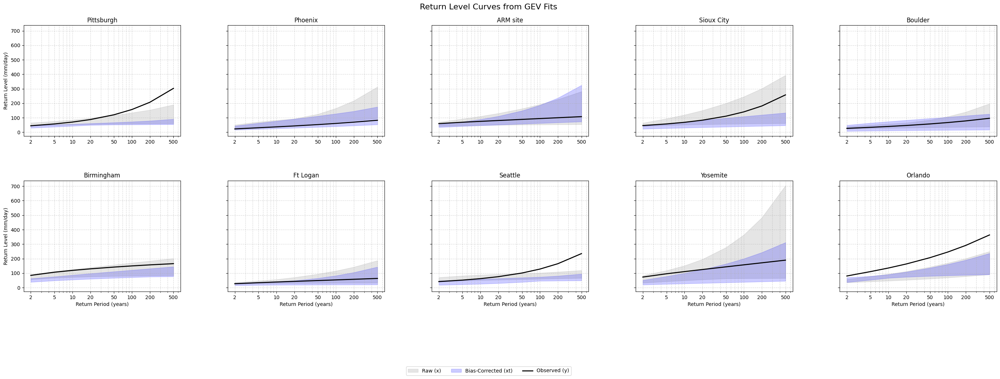

In [15]:
def compute_ensemble_return_levels(data_2d, return_periods):
    """
    Apply fit_stationary_gev to each row in the ensemble (e.g., models).
    Returns stacked return levels: (n_models, len(return_periods))
    """
    rls = []
    for series in data_2d:
        best, _, _ = fit_stationary_gev(series, return_periods)
        rls.append(best)
    return np.stack(rls)  # shape: (n_models, n_rps)


return_periods = [2, 5, 10, 20, 50, 100, 200, 500]
num_cities = len(cities)
ncols = 5
nrows = math.ceil(num_cities / ncols)

fig, axs = plt.subplots(nrows, ncols, figsize=(6 * ncols, 5 * nrows), sharey=True)
axs = np.array(axs).flatten()

for j in range(num_cities):
    ax = axs[j]
    city_name = list(cities.keys())[j]

    max_x = annual_max_x_local[j]       # shape: (n_models, n_years)
    max_xt = annual_max_xt_local[j]
    max_y = annual_max_y_local[j]       # (n_models, n_years) or (n_years,)

    # Compute return levels for all models
    raw_rls = compute_ensemble_return_levels(max_x, return_periods)
    xt_rls = compute_ensemble_return_levels(max_xt, return_periods)

    # Mean observed (y)
    if max_y.ndim == 2:
        y_mean = np.mean(max_y, axis=0)
    else:
        y_mean = max_y
    y_best, _, _ = fit_stationary_gev(y_mean, return_periods)

    # Plot shaded raw
    ax.fill_between(return_periods, raw_rls.min(0), raw_rls.max(0),
                    color='gray', alpha=0.2, label='Raw (x)' if j == 0 else None)

    # Plot shaded bias-corrected
    ax.fill_between(return_periods, xt_rls.min(0), xt_rls.max(0),
                    color='blue', alpha=0.2, label='Bias-Corrected (xt)' if j == 0 else None)

    # Plot observed line
    ax.plot(return_periods, y_best, color='black', linewidth=2, label='Observed (y)' if j == 0 else None)

    ax.set_xscale('log')
    ax.set_xticks(return_periods)
    ax.get_xaxis().set_major_formatter(plt.ScalarFormatter())
    ax.set_title(city_name)
    ax.grid(True, which='both', linestyle='--', alpha=0.5)

    if j % ncols == 0:
        ax.set_ylabel('Return Level (mm/day)')
    if j >= (nrows - 1) * ncols:
        ax.set_xlabel('Return Period (years)')

# Hide unused axes
for j in range(num_cities, len(axs)):
    fig.delaxes(axs[j])

# Add global legend
handles, labels = axs[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.06), ncol=3, fontsize='medium')

fig.subplots_adjust(bottom=0.18, top=0.92, left=0.07, right=0.97, hspace=0.4, wspace=0.3)
fig.suptitle("Return Level Curves from GEV Fits", fontsize=16)

plt.show()


## Annual Cycle

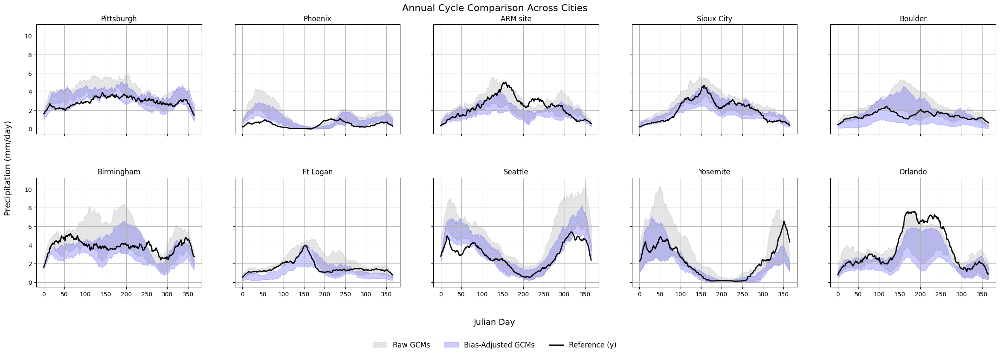

In [33]:
def moving_average(arr, window=30):
    return np.convolve(arr, np.ones(window)/window, mode='same')

window_size = 30
ncols = 5
nrows = 2
num_cities = len(cities)
city_name = list(cities.keys())

fig, axs = plt.subplots(nrows, ncols, figsize=(5 * ncols, 4 * nrows), sharex=True, sharey=True)
axs = axs.flatten()

for j in range(num_cities):
    ax = axs[j]

    all_x = []
    all_xt = []
    all_y = []

    for i in range(len(models)):
        loc = city_index[i][0][j]
        model = models[i]

        time_labels = helper.extract_time_labels(model['x_time_np'], label_type='julian-day')
        label_dummies = pd.get_dummies(time_labels)
        weights_np = label_dummies.div(label_dummies.sum(axis=0), axis=1).values.astype(np.float32)
        # print(weights_np.shape)

        scaled_x = np.einsum('ts,tm->sm', model['x'], weights_np)
        scaled_y = np.einsum('ts,tm->sm', model['y'], weights_np)
        scaled_xt = np.einsum('ts,tm->sm', model['xt'], weights_np)

        all_x.append(moving_average(scaled_x[loc], window_size))
        all_y.append(moving_average(scaled_y[loc], window_size))
        all_xt.append(moving_average(scaled_xt[loc], window_size))

    all_x = np.stack(all_x)
    all_xt = np.stack(all_xt)
    all_y = np.stack(all_y)

    days = np.arange(all_x.shape[1])

    # Shaded region for raw and bias-corrected models
    ax.fill_between(days, all_x.min(0), all_x.max(0), color='gray', alpha=0.2, label='Raw GCMs' if j == 0 else None)
    ax.fill_between(days, all_xt.min(0), all_xt.max(0), color='blue', alpha=0.2, label='Bias-Adjusted GCMs' if j == 0 else None)

    # Reference line
    mean_y = all_y.mean(0)
    ax.plot(days, mean_y, color='black', linewidth=2, label='Reference (y)' if j == 0 else None)

    ax.set_title(f'{city_name[j]}')
    ax.grid(True)

# Clean up unused axes
for j in range(num_cities, len(axs)):
    fig.delaxes(axs[j])

# Global legend and labels
handles, labels = axs[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='lower center', ncol=3, fontsize=12, bbox_to_anchor=(0.5, -0.05), frameon=False)

fig.text(0.5, 0.04, 'Julian Day', ha='center', fontsize=14)
fig.text(0.04, 0.5, 'Precipitation (mm/day)', va='center', rotation='vertical', fontsize=14)

# plt.tight_layout(rect=[0.03, 0.05, 1, 0.95])
fig.subplots_adjust(bottom=0.15, top=0.92, left=0.07, right=0.97, hspace=0.4, wspace=0.2)

fig.suptitle('Annual Cycle Comparison Across Cities', fontsize=16)
plt.savefig(f'{save_path}annual_cycle.png', dpi=300)
plt.show()


In [34]:
def calc_climatology_precip_intensity(prcp, timestamps, wet_threshold=1.0, window=30):
    """
    Compute daily climatology of precipitation intensity (mean precip on wet days),
    by first computing per-year DOY intensities, then averaging.

    Parameters:
        prcp (np.ndarray): (time, n_coords) daily precipitation
        timestamps (array-like): (time,) datetime64 array
        wet_threshold (float): threshold for wet days (default 1.0 mm/day)
        window (int): moving average window in days (default 30)

    Returns:
        intensity_clim (np.ndarray): (365, n_coords) array of climatological intensities
    """
    df = pd.DataFrame({
        'year': pd.to_datetime(timestamps).year,
        'doy': pd.to_datetime(timestamps).dayofyear
    })
    df['doy'] = df['doy'].clip(upper=365)

    years = df['year'].unique()
    n_coords = prcp.shape[1]
    per_year_intensity = {year: np.full((365, n_coords), np.nan) for year in years}

    for year in years:
        year_idx = df['year'] == year
        prcp_year = prcp[year_idx]
        doy_year = df.loc[year_idx, 'doy'].values

        # Prepare day-of-year bins
        for doy in range(1, 366):
            # 30-day window: circular for early/late year
            half_win = window // 2
            window_range = [(doy - half_win + i - 1) % 365 + 1 for i in range(window)]
            day_mask = np.isin(doy_year, window_range)

            if not np.any(day_mask):
                continue

            data_window = prcp_year[day_mask]
            wet_mask = data_window > wet_threshold
            wet_counts = wet_mask.sum(axis=0)

            with np.errstate(invalid='ignore', divide='ignore'):
                intensity = np.where(
                    wet_counts > 0,
                    data_window.sum(axis=0) / wet_counts,
                    np.nan
                )

            per_year_intensity[year][doy - 1, :] = intensity

    # Stack years → (n_years, 365, n_coords) → then take mean over years
    intensity_all_years = np.stack(list(per_year_intensity.values()), axis=0)
    intensity_clim = np.nanmean(intensity_all_years, axis=0)  # (365, n_coords)

    return intensity_clim

/tmp/ipykernel_786763/4027241461.py:55: RuntimeWarning: Mean of empty slice
  intensity_clim = np.nanmean(intensity_all_years, axis=0)  # (365, n_coords)
/tmp/ipykernel_786763/4027241461.py:55: RuntimeWarning: Mean of empty slice
  intensity_clim = np.nanmean(intensity_all_years, axis=0)  # (365, n_coords)
/tmp/ipykernel_786763/4027241461.py:55: RuntimeWarning: Mean of empty slice
  intensity_clim = np.nanmean(intensity_all_years, axis=0)  # (365, n_coords)
/tmp/ipykernel_786763/4027241461.py:55: RuntimeWarning: Mean of empty slice
  intensity_clim = np.nanmean(intensity_all_years, axis=0)  # (365, n_coords)
/tmp/ipykernel_786763/4027241461.py:55: RuntimeWarning: Mean of empty slice
  intensity_clim = np.nanmean(intensity_all_years, axis=0)  # (365, n_coords)
/tmp/ipykernel_786763/4027241461.py:55: RuntimeWarning: Mean of empty slice
  intensity_clim = np.nanmean(intensity_all_years, axis=0)  # (365, n_coords)
/tmp/ipykernel_786763/4027241461.py:55: RuntimeWarning: Mean of empty slice


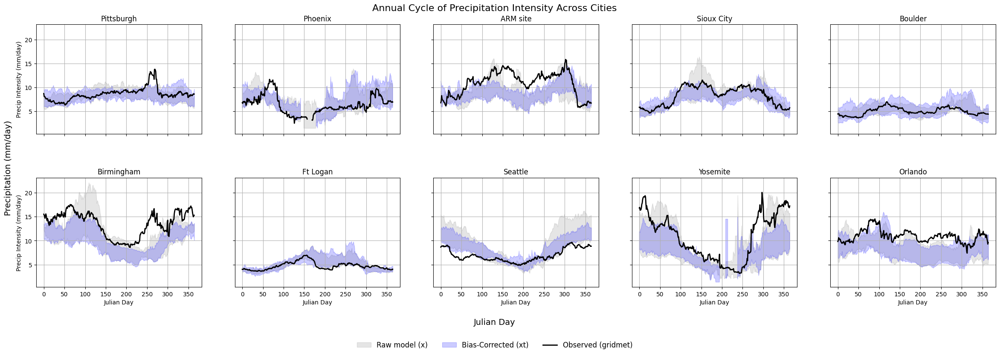

In [35]:
num_cities = len(cities)
ncols = 5
nrows = math.ceil(num_cities / ncols)
scale = 'Julian Day'

fig, axs = plt.subplots(nrows, ncols, figsize=(5 * ncols, 4 * nrows), sharex=True, sharey=True)
axs = axs.flatten()

ref_label = models[0]['config']['ref']

for j in range(num_cities):
    ax = axs[j]
    city_name = list(cities.keys())[j]

    all_x = []
    all_xt = []
    all_y = []

    for i in range(len(models)):
        model = models[i]
        loc = city_index[i][0][j]
        x_intensity = calc_climatology_precip_intensity(model['x'], model['x_time_np'])[:, loc]
        xt_intensity = calc_climatology_precip_intensity(model['xt'], model['x_time_np'])[:, loc]
        y_intensity = calc_climatology_precip_intensity(model['y'], model['x_time_np'])[:, loc]

        all_x.append(x_intensity)
        all_xt.append(xt_intensity)
        all_y.append(y_intensity)

    all_x = np.stack(all_x)
    all_xt = np.stack(all_xt)
    all_y = np.stack(all_y)

    days = np.arange(all_x.shape[1])

    # Shaded range for raw models (x)
    ax.fill_between(days, all_x.min(axis=0), all_x.max(axis=0),
                    color='gray', alpha=0.2, label='Raw model (x)' if j == 0 else None)

    # Shaded range for bias-corrected models (xt)
    ax.fill_between(days, all_xt.min(axis=0), all_xt.max(axis=0),
                    color='blue', alpha=0.2, label='Bias-Corrected (xt)' if j == 0 else None)

    # Bold line for mean observed (y)
    ax.plot(all_y.mean(axis=0), color='black', linewidth=2, label=f'Observed ({ref_label})' if j == 0 else None)

    ax.set_title(city_name)
    ax.grid(True)
    if j % ncols == 0:
        ax.set_ylabel('Precip Intensity (mm/day)')
    if j >= (nrows - 1) * ncols:
        ax.set_xlabel(scale)

# Hide unused axes
for k in range(num_cities, len(axs)):
    fig.delaxes(axs[k])

# Global legend and labels
handles, labels = axs[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='lower center', ncol=3, fontsize=12, bbox_to_anchor=(0.5, -0.05), frameon=False)

fig.text(0.5, 0.04, 'Julian Day', ha='center', fontsize=14)
fig.text(0.04, 0.5, 'Precipitation (mm/day)', va='center', rotation='vertical', fontsize=14)

# plt.tight_layout(rect=[0.03, 0.05, 1, 0.95])
fig.subplots_adjust(bottom=0.15, top=0.92, left=0.07, right=0.97, hspace=0.4, wspace=0.2)
fig.suptitle('Annual Cycle of Precipitation Intensity Across Cities', fontsize=16)

plt.show()

## Seasonal

In [8]:
import copy
models_seasonal = copy.deepcopy(models)

loca_seasonal = []
QM_seasonal = []

for i in range(len(models)):
    models_seasonal[i]['x'] = load_seasonal_data(models[i]['x_time_np'], models[i]['x'])
    models_seasonal[i]['y'] = load_seasonal_data(models[i]['x_time_np'], models[i]['y'])
    models_seasonal[i]['xt'] = load_seasonal_data(models[i]['x_time_np'], models[i]['xt'])
    models_seasonal[i]['x_time_np'] = load_seasonal_data(models[i]['x_time_np'], models[i]['x_time_np'])

# ref_eval_data_seasonal = models_seasonal[exps.index(ref_eval)]['y']


    loca_seasonal.append(load_seasonal_data(models[i]['x_time_np'], loca_all[i]))

    # if 'QM' in method_names:
    QM_seasonal.append(load_seasonal_data(models[i]['x_time_np'], QM_all[i]))


In [9]:
x_ensemble_indices_season = {}
xt_ensemble_indices_season = {}
loca_ensemble_indices_season = {}
QM_ensemble_indices_season= {}

interp_coords = []
ensemble_coords = valid_coords[2]
for coords in valid_coords:
    interp_coords.append(find_nearest_indices(ensemble_coords, coords))

# Initialize climate indices manager
climate_indices = ClimateIndices()

thresholds = climate_indices.get_indices() 

for season in ['Spring', 'Winter', 'Autumn', 'Summer']:

    counter = 0 
    for model in models_seasonal:

        for label, (threshold, comparison) in thresholds.items():
            if callable(threshold):  # If function, apply it to y
                model[f'{label}_x_{season}'] = threshold(model['x_time_np'][season], model['x'][season])
                model[f'{label}_y_{season}'] = threshold(model['x_time_np'][season], model['y'][season])
                model[f'{label}_xt_{season}'] = threshold(model['x_time_np'][season], model['xt'][season])
                model[f'{label}_loca_{season}'] = threshold(model['x_time_np'][season], loca_seasonal[counter][season])
                model[f'{label}_QM_{season}'] = threshold(model['x_time_np'][season], QM_seasonal[counter][season])

                if f'{label}_{season}' not in x_ensemble_indices_season:
                    x_ensemble_indices_season[f'{label}_{season}'] = model[f'{label}_x_{season}'][:, interp_coords[counter][0]]/len(models)
                    # y_ensemble_indices[label] = model[f'{label}_y'][:, interp_coords[counter][0]]
                    xt_ensemble_indices_season[f'{label}_{season}'] = model[f'{label}_xt_{season}'][:, interp_coords[counter][0]]/len(models)
                    loca_ensemble_indices_season[f'{label}_{season}'] = model[f'{label}_loca_{season}'][:, interp_coords[counter][0]]/len(models)
                    QM_ensemble_indices_season[f'{label}_{season}'] = model[f'{label}_QM_{season}'][:, interp_coords[counter][0]]/len(models)
                else:
                    x_ensemble_indices_season[f'{label}_{season}'] += model[f'{label}_x_{season}'][:, interp_coords[counter][0]]/len(models)
                    xt_ensemble_indices_season[f'{label}_{season}'] += model[f'{label}_xt_{season}'][:, interp_coords[counter][0]]/len(models)
                    loca_ensemble_indices_season[f'{label}_{season}'] += model[f'{label}_loca_{season}'][:, interp_coords[counter][0]]/len(models)
                    QM_ensemble_indices_season[f'{label}_{season}'] += model[f'{label}_QM_{season}'][:, interp_coords[counter][0]]/len(models)
        counter+=1

In [10]:
bias_dict_season = {}
for season in ['Spring', 'Winter', 'Autumn', 'Summer']:

    bias_dict_season[season] = {}

    for label, (threshold, comparison) in thresholds.items():
        y_ensemble_indices = models_seasonal[2]
        if callable(threshold):
            xt_bias = compute_mean_bias_percentage(None, x_ensemble_indices_season[f'{label}_{season}'], y_ensemble_indices[f'{label}_y_{season}'], xt_ensemble_indices_season[f'{label}_{season}'])
            loca_bias = compute_mean_bias_percentage(None, x_ensemble_indices_season[f'{label}_{season}'], y_ensemble_indices[f'{label}_y_{season}'], loca_ensemble_indices_season[f'{label}_{season}'])
            QM_bias = compute_mean_bias_percentage(None, x_ensemble_indices_season[f'{label}_{season}'], y_ensemble_indices[f'{label}_y_{season}'], QM_ensemble_indices_season[f'{label}_{season}'])

            bias_dict_season[season][label] = (xt_bias[0], xt_bias[1], loca_bias[1], QM_bias[1])

/pscratch/sd/k/kas7897/diffDownscale/eval/metrics.py:190: RuntimeWarning: Mean of empty slice
  percent_bias_x = np.nanmean(bias_x, axis=0)  # shape: (n_grid,)
/pscratch/sd/k/kas7897/diffDownscale/eval/metrics.py:191: RuntimeWarning: Mean of empty slice
  percent_bias_xt = np.nanmean(bias_xt, axis=0)


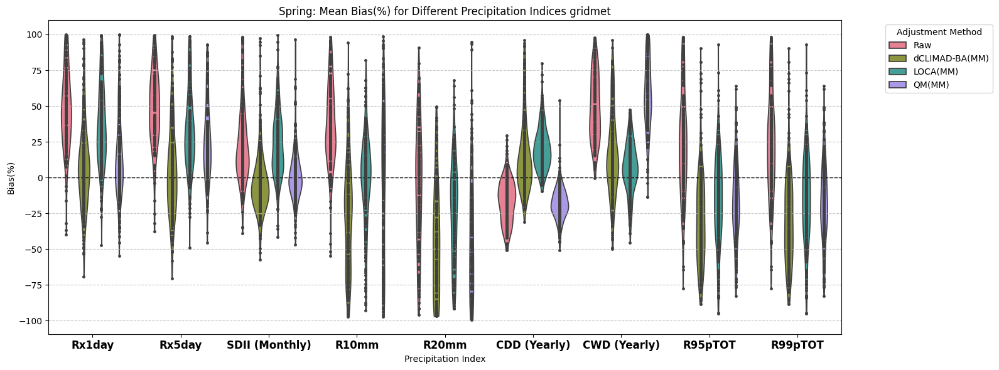

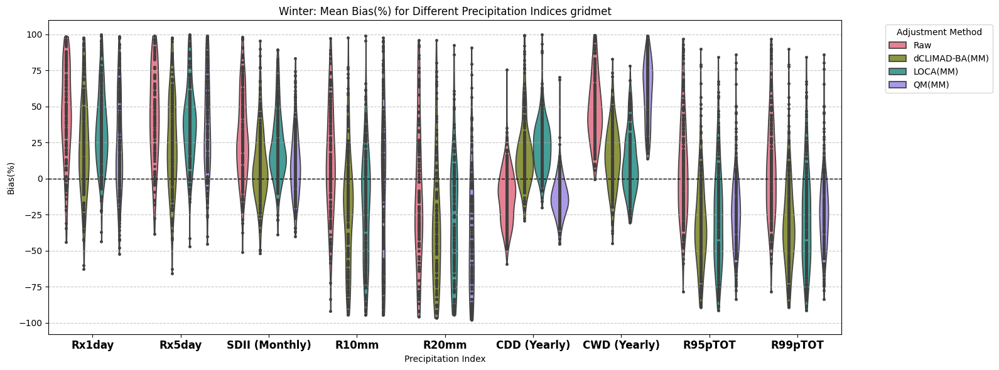

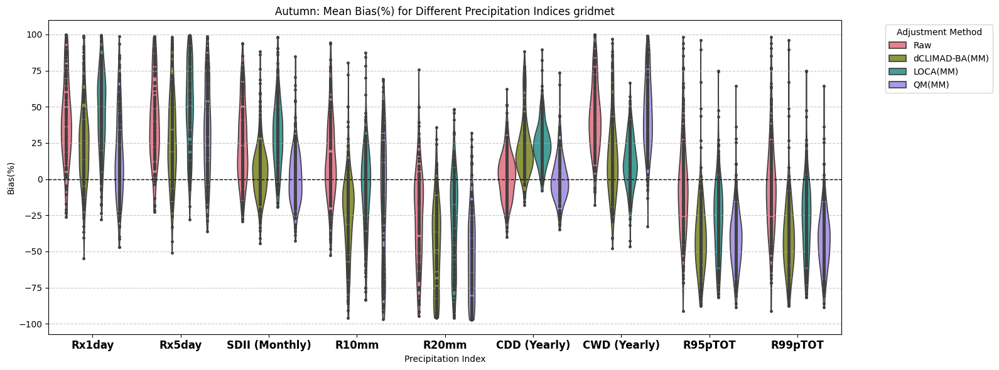

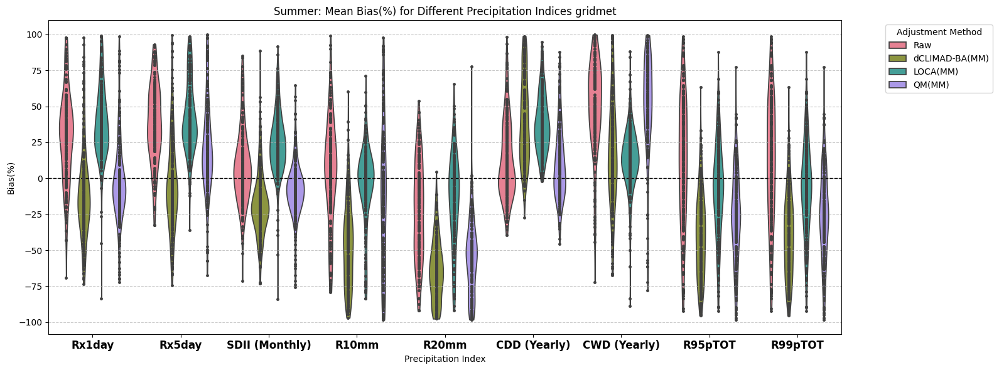

In [11]:
for season in ['Spring', 'Winter', 'Autumn', 'Summer']:

    keys = ['SDII (Monthly)','CDD (Yearly)', 'CWD (Yearly)', "Rx1day", "Rx5day", "R10mm",  "R20mm", "R95pTOT", "R99pTOT"]
    d = dict(filter(lambda item: item[0] in keys , bias_dict_season[season].items()))



    # Create a 2x2 subplot figure
    fig, axes = plt.subplots(1, 1, figsize=(16, 6), sharey=True)


    ref_label = models_seasonal[0]['config']['ref']
    method_names = ['dCLIMAD-BA(MM)', 'LOCA(MM)', 'QM(MM)'] 
    # Call the function for each dataset
    plot_violin_bias(axes, d, "Bias(%)", f"{season}: Mean Bias(%) for Different Precipitation Indices {ref_label}",  method_names=method_names, remove_outlier=True)

    # plot_violin_bias(axes[1], d4, "Bias(%)", "Day Bias(%) for Different Precipitation Indices",  method_names=method_names, remove_outlier=True)
    # fig.suptitle(f'Ensemble-Livneh', fontsize=20, fontweight="bold", y=1.02)


    plt.tight_layout()
    plt.savefig(f'{save_path}violin_Pindices_{season}.png')

    plt.show()

### Spatial Patterns

In [49]:
interp_coords = []
ensemble_coords = valid_coords[1]
for coords in valid_coords:
    interp_coords.append(find_nearest_indices(ensemble_coords, coords))

In [50]:
fixed_coords = valid_coords[1]
unique_lats = np.unique(fixed_coords[:, 1])

lat_models_x=[]
lat_models_y=[]
lat_models_xt=[]
lat_models_QM=[]
lat_models_loca=[]

for j in range(len(models)):
    # Example: xt = models[0]['xt']  # shape (time, coords)
    xt_ = models[j]['xt']  # shape (time, coords)
    x_ = models[j]['x']  # shape (time, coords)
    y_ = models[j]['y']  # shape (time, coords)
    QM_ = QM_all[j]  # shape (time, coords)
    loca_ = loca_all[j]  # shape (time, coords)

    interp_idx = interp_coords[j][0]  # shape (coords, 2)

    # For each latitude, find indices of coords with that latitude
    lat_to_indices = defaultdict(list)
    for idx, lat in enumerate(fixed_coords[:, 1]):
        lat_to_indices[lat].append(idx)

    # For each latitude, average precipitation over all longitudes (coords) at that latitude
    mean_precip_per_lat_xt = []
    mean_precip_per_lat_x = []
    mean_precip_per_lat_y = []
    mean_precip_per_lat_QM = []
    mean_precip_per_lat_loca = []

    for lat in unique_lats:
        indices = lat_to_indices[lat]
        # xt[:, indices] is (time, n_lons_at_lat)
        mean_over_lon_xt = xt_[:, interp_idx][:, indices].mean(axis=1)  # mean over longitude for each time
        # If you want mean over time as well:
        mean_over_lon_and_time_xt = mean_over_lon_xt.mean()  # scalar
        mean_precip_per_lat_xt.append(mean_over_lon_and_time_xt)

        mean_over_lon_x = x_[:, interp_idx][:, indices].mean(axis=1)  # mean over longitude for each time
        # If you want mean over time as well:
        mean_over_lon_and_time_x = mean_over_lon_x.mean()  # scalar
        mean_precip_per_lat_x.append(mean_over_lon_and_time_x)

        mean_over_lon_y = y_[:, interp_idx][:, indices].mean(axis=1)  # mean over longitude for each time
        # If you want mean over time as well:
        mean_over_lon_and_time_y = mean_over_lon_y.mean()  # scalar
        mean_precip_per_lat_y.append(mean_over_lon_and_time_y)

        mean_over_lon_QM = QM_[:, interp_idx][:, indices].mean(axis=1)  # mean over longitude for each time
        # If you want mean over time as well:
        mean_over_lon_and_time_QM = mean_over_lon_QM.mean()  # scalar
        mean_precip_per_lat_QM.append(mean_over_lon_and_time_QM)

        mean_over_lon_loca = loca_[:, interp_idx][:, indices].mean(axis=1)  # mean over longitude for each time
        # If you want mean over time as well:
        mean_over_lon_and_time_loca = mean_over_lon_loca.mean()  # scalar
        mean_precip_per_lat_loca.append(mean_over_lon_and_time_loca)





    # Convert to array for plotting or further analysis
    lat_models_xt.append(np.array(mean_precip_per_lat_xt)) # shape (n_lats,)
    lat_models_x.append(np.array(mean_precip_per_lat_x))  # shape (n_lats,)
    lat_models_y.append(np.array(mean_precip_per_lat_y))  # shape (n_lats,)
    lat_models_QM.append(np.array(mean_precip_per_lat_QM))  # shape (n_lats,)
    lat_models_loca.append(np.array(mean_precip_per_lat_loca))  # shape (n_lats,)

# Now, unique_lats gives the latitude values, mean_precip_per_lat gives the mean precipitation at each latitude

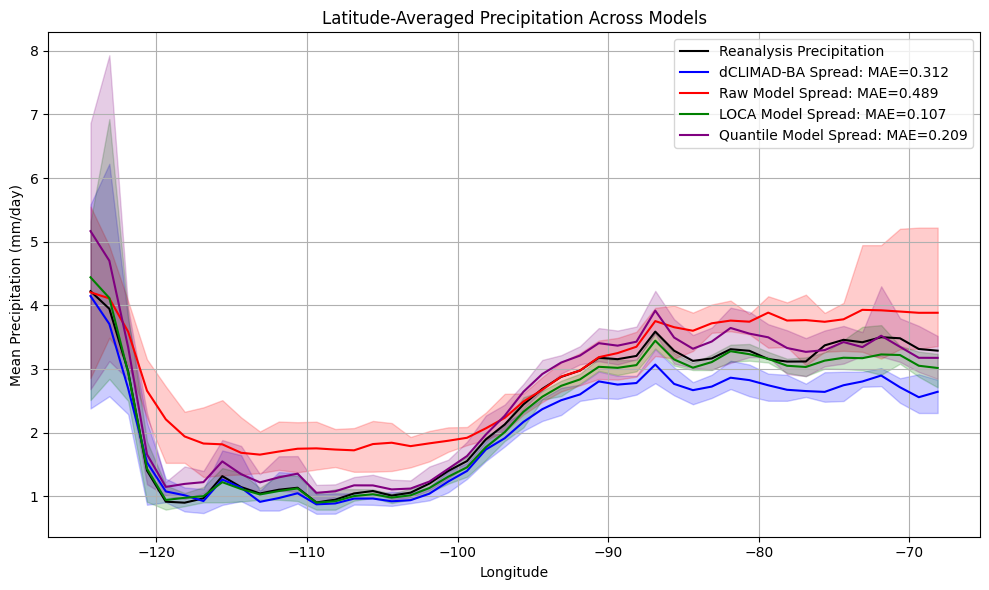

In [51]:
lat_models_xt_arr = np.stack(lat_models_xt)  # shape: (n_models, n_lats)
lat_models_x_arr = np.stack(lat_models_x)  # shape: (n_models, n_lats)
lat_models_y_arr = np.stack(lat_models_y)  # shape: (n_models, n_lats)
lat_models_QM_arr = np.stack(lat_models_QM)  # shape: (n_models, n_lats)
lat_models_loca_arr = np.stack(lat_models_loca)  # shape: (n_models, n_lats)

# Calculate mean, min, max across models for each latitude
mean_xt = lat_models_xt_arr.mean(axis=0)
min_xt = lat_models_xt_arr.min(axis=0)
max_xt = lat_models_xt_arr.max(axis=0)

mean_x = lat_models_x_arr.mean(axis=0)
min_x = lat_models_x_arr.min(axis=0)
max_x = lat_models_x_arr.max(axis=0)

mean_y = lat_models_y_arr.mean(axis=0)
min_y = lat_models_y_arr.min(axis=0)
max_y = lat_models_y_arr.max(axis=0)

mean_QM = lat_models_QM_arr.mean(axis=0)
min_QM = lat_models_QM_arr.min(axis=0)
max_QM = lat_models_QM_arr.max(axis=0)

mean_loca = lat_models_loca_arr.mean(axis=0)
min_loca = lat_models_loca_arr.min(axis=0)
max_loca = lat_models_loca_arr.max(axis=0)



plt.figure(figsize=(10, 6))
plt.plot(unique_lats, mean_y, color='black', label=f'Reanalysis Precipitation')
plt.plot(unique_lats, mean_xt, color='blue', label=f'dCLIMAD-BA Spread: MAE={np.abs(mean_xt - mean_y).mean():.3f}')
plt.plot(unique_lats, mean_x, color='red', label=f'Raw Model Spread: MAE={np.abs(mean_x - mean_y).mean():.3f}')
plt.plot(unique_lats, mean_loca, color='green', label=f'LOCA Model Spread: MAE={np.abs(mean_loca - mean_y).mean():.3f}')
plt.plot(unique_lats, mean_QM, color='purple', label=f'Quantile Model Spread: MAE={np.abs(mean_QM - mean_y).mean():.3f}')


plt.fill_between(unique_lats, min_xt, max_xt, color='blue', alpha=0.2)
plt.fill_between(unique_lats, min_x, max_x, color='red', alpha=0.2)
plt.fill_between(unique_lats, min_loca, max_loca, color='green', alpha=0.2)
plt.fill_between(unique_lats, min_QM, max_QM, color='purple', alpha=0.2)

plt.xlabel('Longitude')
plt.ylabel('Mean Precipitation (mm/day)')
plt.title('Latitude-Averaged Precipitation Across Models')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.savefig(f'{save_path}LatAverage.png')
plt.show()

In [53]:
xt_nc_all = []
x_nc_all = []
y_nc_all = []
loca_nc_all = []
QM_nc_all = []
for i in range(len(models)):

    xt_nc = valid_crd.reconstruct_nc(models[i]['xt'], valid_coords[i], models[i]['x_time_np'], var='pr')
    xt_nc_all.append(xt_nc['pr'].values.mean(axis=0))

    x_nc = valid_crd.reconstruct_nc(models[i]['x'], valid_coords[i], models[i]['x_time_np'], var='pr')
    x_nc_all.append(x_nc['pr'].values.mean(axis=0))

    y_nc = valid_crd.reconstruct_nc(models[i]['y'], valid_coords[i], models[i]['x_time_np'], var='pr')
    y_nc_all.append(y_nc['pr'].values.mean(axis=0))

    loca_nc = valid_crd.reconstruct_nc(loca_all[i], valid_coords[i], models[i]['x_time_np'], var='pr')
    loca_nc_all.append(loca_nc['pr'].values.mean(axis=0))

    QM_nc = valid_crd.reconstruct_nc(QM_all[i], valid_coords[i], models[i]['x_time_np'], var='pr')
    QM_nc_all.append(QM_nc['pr'].values.mean(axis=0))

/pscratch/sd/k/kas7897/dCLIMAD_BA/data/valid_crd.py:86: UserWarning: Converting non-nanosecond precision datetime values to nanosecond precision. This behavior can eventually be relaxed in xarray, as it is an artifact from pandas which is now beginning to support non-nanosecond precision values. This warning is caused by passing non-nanosecond np.datetime64 or np.timedelta64 values to the DataArray or Variable constructor; it can be silenced by converting the values to nanosecond precision ahead of time.
  ds_filtered = xr.Dataset(
/pscratch/sd/k/kas7897/dCLIMAD_BA/data/valid_crd.py:86: UserWarning: Converting non-nanosecond precision datetime values to nanosecond precision. This behavior can eventually be relaxed in xarray, as it is an artifact from pandas which is now beginning to support non-nanosecond precision values. This warning is caused by passing non-nanosecond np.datetime64 or np.timedelta64 values to the DataArray or Variable constructor; it can be silenced by converting th

In [ ]:
def fractal_dimension(Z, threshold):
    """
    Calculate the fractal dimension of a 2D array Z using box-counting.
    Handles NaNs by replacing them with 0.
    """
    assert len(Z.shape) == 2
    Z = np.nan_to_num(Z, nan=0)  # Replace NaN with 0
    Z_bin = (Z < threshold)
    p = min(Z_bin.shape)
    # n = 2 ** np.floor(np.log(p) / np.log(2))
    n = int(np.log(p) / np.log(2))
    sizes = 2 ** np.arange(n, 1, -1)

    def boxcount(Z, k):
        S = np.add.reduceat(
            np.add.reduceat(Z, np.arange(0, Z.shape[0], k), axis=0),
            np.arange(0, Z.shape[1], k), axis=1)
        return len(np.where((S > 0) & (S < k * k))[0])

    counts = [boxcount(Z_bin, size) for size in sizes]
    coeffs = np.polyfit(np.log(sizes), np.log(counts), 1)
    return -coeffs[0]

# Example usage:
# Z = np.random.rand(64, 64)

## arrange numbers between 0 and 1
quantiles = np.arange(0, 1.00, 0.0001)

dim_xt_all = []
dim_x_all = []
dim_y_all = []
dim_loca_all = []
dim_QM_all = []

for i in range(len(models)):
 
    dim_xt = []
    dim_x = []
    dim_y = []
    dim_loca = []
    dim_QM = []
    for q in quantiles:
        threshold_xt = np.nanquantile(xt_nc_all[i], q)
        dim_xt.append(fractal_dimension(xt_nc_all[i], threshold_xt))

        threshold_x = np.nanquantile(x_nc_all[i], q)
        dim_x.append(fractal_dimension(x_nc_all[i], threshold_x))

        threshold_y = np.nanquantile(y_nc_all[i], q)
        dim_y.append(fractal_dimension(y_nc_all[i], threshold_y))

        threshold_loca = np.nanquantile(loca_nc_all[i], q)
        dim_loca.append(fractal_dimension(loca_nc_all[i], threshold_loca))

        threshold_QM = np.nanquantile(QM_nc_all[i], q)
        dim_QM.append(fractal_dimension(QM_nc_all[i], threshold_QM))

    dim_xt_all.append(dim_xt)
    dim_x_all.append(dim_x)
    dim_y_all.append(dim_y)
    dim_loca_all.append(dim_loca)
    dim_QM_all.append(dim_QM)

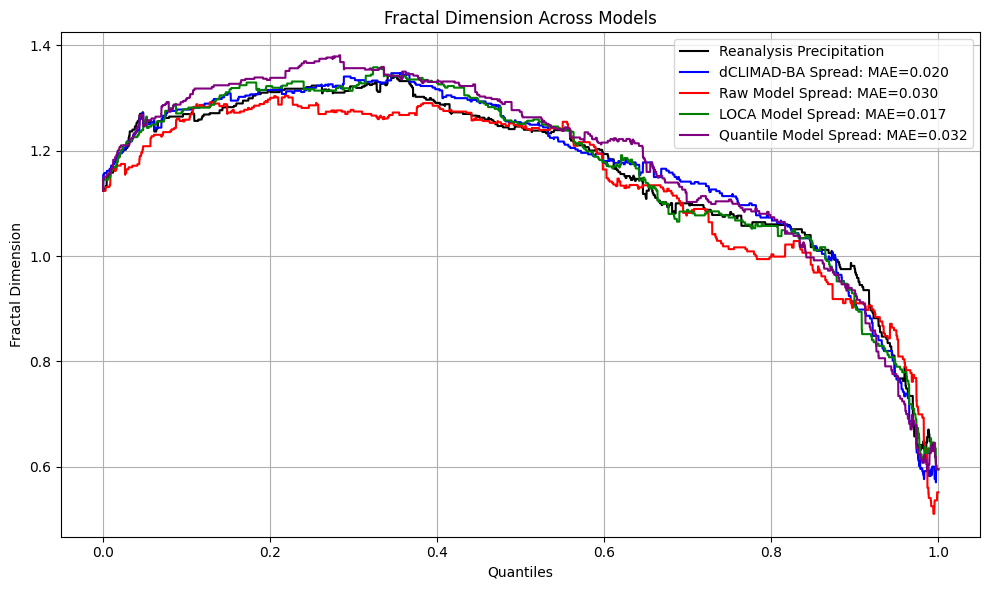

In [56]:
dim_xt_arr = np.stack(dim_xt_all)  # shape: (n_models, n_quantiles)
dim_x_arr = np.stack(dim_x_all)  # shape: (n_models, n_quantiles)
dim_y_arr = np.stack(dim_y_all)  # shape: (n_models, n_quantiles)
dim_loca_arr = np.stack(dim_loca_all)  # shape: (n_models, n_quantiles)
dim_QM_arr = np.stack(dim_QM_all)  # shape: (n_models, n_quantiles)



# Calculate mean, min, max across models for each latitude
dim_mean_xt = dim_xt_arr.mean(axis=0)
dim_min_xt = dim_xt_arr.min(axis=0)
dim_max_xt = dim_xt_arr.max(axis=0)

dim_mean_x = dim_x_arr.mean(axis=0)
dim_min_x = dim_x_arr.min(axis=0)
dim_max_x = dim_x_arr.max(axis=0)

dim_mean_y = dim_y_arr.mean(axis=0)
dim_min_y = dim_y_arr.min(axis=0)
dim_max_y = dim_y_arr.max(axis=0)

dim_mean_QM = dim_QM_arr.mean(axis=0)
dim_min_QM = dim_QM_arr.min(axis=0)
dim_max_QM = dim_QM_arr.max(axis=0)

dim_mean_loca = dim_loca_arr.mean(axis=0)
dim_min_loca = dim_loca_arr.min(axis=0)
dim_max_loca = dim_loca_arr.max(axis=0)



plt.figure(figsize=(10, 6))
plt.plot(quantiles, dim_mean_y, color='black', label=f'Reanalysis Precipitation')
plt.plot(quantiles, dim_mean_xt, color='blue', label=f'dCLIMAD-BA Spread: MAE={np.abs(dim_mean_xt - dim_mean_y).mean():.3f}')
plt.plot(quantiles, dim_mean_x, color='red', label=f'Raw Model Spread: MAE={np.abs(dim_mean_x - dim_mean_y).mean():.3f}')
plt.plot(quantiles, dim_mean_loca, color='green', label=f'LOCA Model Spread: MAE={np.abs(dim_mean_loca - dim_mean_y).mean():.3f}')
plt.plot(quantiles, dim_mean_QM, color='purple', label=f'Quantile Model Spread: MAE={np.abs(dim_mean_QM - dim_mean_y).mean():.3f}')


# plt.fill_between(quantiles, dim_min_xt, dim_max_xt, color='blue', alpha=0.2)
# plt.fill_between(quantiles, dim_min_x, dim_max_x, color='red', alpha=0.2)
# plt.fill_between(quantiles, dim_min_loca, dim_max_loca, color='green', alpha=0.2)
# plt.fill_between(quantiles, dim_min_QM, dim_max_QM, color='purple', alpha=0.2)

plt.xlabel('Quantiles')
plt.ylabel('Fractal Dimension')
plt.title('Fractal Dimension Across Models')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.savefig(f'{save_path}fractalDim.png')
plt.show()
        
